## General

This notebook combines the image and text models using different distance and combination heuristics.

In [1]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import nltk
import scipy
from PIL import Image
from sklearn.neighbors import NearestNeighbors

In [2]:
# Set image directory
train_dir = '../datasets/train_images'

In [3]:
# Load image predictions and F1 scores
train_image = pd.DataFrame(np.load('../datasets/train_image_predictions.npy', allow_pickle=True),
                     columns=['posting_id', 'image', 'image_phash', 'title', 'label_group', 'matches', 'image_duplicates',
                              'predictions_6e', 'f1_scores_6e', 'predictions_6c', 'f1_scores_6c',
                              'predictions_8e', 'f1_scores_8e', 'predictions_8c', 'f1_scores_8c'])

In [4]:
# Load text predictions and F1 scores
train_text = pd.DataFrame(np.load('../datasets/train_text_predictions.npy', allow_pickle=True),
                     columns=['posting_id', 'image', 'title', 'matches',
                              'tokens_2', 'text_predictions_2e', 'text_f1_scores_2e',
                              'text_predictions_2c', 'text_f1_scores_2c',
                              'tokens_3', 'text_predictions_3e', 'text_f1_scores_3e',
                              'text_predictions_3c', 'text_f1_scores_3c'])

In [5]:
# Combine best image and text predictions
train = pd.concat([# Best image predictions (image model 8c)
                   train_image[['posting_id', 'image', 'image_phash', 'title',
                                'label_group', 'matches', 'image_duplicates',
                                'predictions_8c', 'f1_scores_8c']],
                  
                   # Best text predictions (text model 3c)
                   train_text[['text_predictions_3c', 'text_f1_scores_3c']]],
                   axis=1)

train.rename(columns={'predictions_8c': 'best_image_preds_0',
                      'f1_scores_8c': 'best_image_scores_0',
                      'text_predictions_3c': 'best_text_preds_0',
                      'text_f1_scores_3c': 'best_text_scores_0'},
             inplace=True)

train['best_image_scores_0'] = train['best_image_scores_0'].astype('float64')
train['best_text_scores_0'] = train['best_text_scores_0'].astype('float64')

In [6]:
train.head()

,posting_id,image,image_phash,title,label_group,matches,image_duplicates,best_image_preds_0,best_image_scores_0,best_text_preds_0,best_text_scores_0
0,train_129225211,0000a68812bc7e98c42888dfb1c07da0.jpg,94974f937d4c2433,Paper Bag Victoria Secret,249114794,"[train_129225211, train_2278313361]",[train_129225211],[train_129225211],0.666667,"[train_129225211, train_2278313361]",1.000000
1,train_3386243561,00039780dfc94d01db8676fe789ecd05.jpg,af3f9460c2838f0f,"Double Tape 3M VHB 12 mm x 4,5 m ORIGINAL / DO...",2937985045,"[train_3386243561, train_3423213080]",[train_3386243561],"[train_3386243561, train_3423213080, train_212...",0.500000,"[train_3386243561, train_3423213080, train_197...",0.500000
2,train_2288590299,000a190fdd715a2a36faed16e2c65df7.jpg,b94cb00ed3e50f78,Maling TTS Canned Pork Luncheon Meat 397 gr,2395904891,"[train_2288590299, train_3803689425]",[train_2288590299],[train_2288590299],0.666667,"[train_2288590299, train_3803689425]",1.000000
3,train_2406599165,00117e4fc239b1b641ff08340b429633.jpg,8514fc58eafea283,Daster Batik Lengan pendek - Motif Acak / Camp...,4093212188,"[train_2406599165, train_3342059966]",[train_2406599165],"[train_2406599165, train_1593362411, train_280...",0.333333,"[train_1744956981, train_2406599165, train_352...",0.222222
4,train_3369186413,00136d1cf4edede0203f32f05f660588.jpg,a6f319f924ad708c,Nescafe \xc3\x89clair Latte 220ml,3648931069,"[train_3369186413, train_921438619]",[train_3369186413],"[train_3369186413, train_921438619]",1.000000,[train_3369186413],0.666667


In [7]:
# Create function to score predictions based on actual matches
def scores(matches, preds):
    result = []
    for i in range(len(matches)):
        n = len(np.intersect1d(matches[i], preds[i]))
        score = 2*n / (len(matches[i]) + len(preds[i]))
        result.append(score)
    return result

In [8]:
# Obtain matches
matches = list(train['matches'].to_numpy())

## Baseline Heuristics

As a start, we can combine the best image predictions with the best text predictions using either the union or intersection of the 2 sets of predictions.

- Set union of image and text predictions
- Set intersection of image and text predictions

### Set Union of Image and Text Predictions

As a baseline, try the set union of image and text predictions.

In [9]:
# Create combined predictions using union of image and text predictions
preds_union = []

for i in range(train.shape[0]):
    preds_union.append(np.union1d(train['best_image_preds_0'].iloc[i], train['best_text_preds_0'].iloc[i]))

In [10]:
# Check average score
np.mean(scores(matches, preds_union))

0.7451648274871532

In [11]:
# Create column in train df for baseline combined predictions and scores
train['combined_preds_0'] = preds_union
train['combined_scores_0'] = scores(matches, preds_union)

### Set Intersection of Image and Text Predictions

Try the set intersection of image and text predictions.

In [12]:
# Create combined predictions using union of image and text predictions
preds_intersect = []

for i in range(train.shape[0]):
    preds_intersect.append(np.intersect1d(train['best_image_preds_0'].iloc[i], train['best_text_preds_0'].iloc[i]))

In [13]:
# Check average score
np.mean(scores(matches, preds_intersect))

0.6063594482704427

As expected, there are not many products that are similar in <em>both</em> image and text, thus the intersection scores are lower.

## Explore Image/Text Distances and Indices

Currently, the best image predictions use a fixed cosine distance threshold of 0.233 and the best text predictions use a fixed cosine distance threshold of 0.433.

Explore the actual image/text distances of the product matches as well as the predicted matches to develop a better heuristic.

In [14]:
# Import scipy distance metric
from scipy.spatial import distance

In [15]:
# Load image/text distances and indices
image_distances = np.load('../datasets/best_image_distances.npy')
image_indices = np.load('../datasets/best_image_indices.npy')

text_distances = np.load('../datasets/best_text_distances.npy')
text_indices = np.load('../datasets/best_text_indices.npy')

In [16]:
# Load best image/text embeddings
image_embeddings = np.load('../datasets/train_image_embeddings_8.npy', allow_pickle=True)
text_embeddings = scipy.sparse.load_npz('../datasets/train_text_embeddings.npz')

In [18]:
# Generate image distances of actual product matches
actual_image_distances = []
for i in range(train.shape[0]):
    distances = []
    matches = train['matches'].iloc[i]
    
    # Obtain indexes of matches
    for match in matches:
        match_idx = train[train['posting_id'] == match].index.values[0]
        
        # Calculate cosine distance of matches to product
        distances.append(distance.cosine(image_embeddings[i], image_embeddings[match_idx]))
    
    actual_image_distances.append(distances)

KeyboardInterrupt: 

In [ ]:
# Generate text distances of actual product matches
actual_text_distances = []
for i in range(train.shape[0]):
    distances = []
    matches = train['matches'].iloc[i]
    
    # Obtain indexes of matches
    for match in matches:
        match_idx = train[train['posting_id'] == match].index.values[0]
        
        # Calculate cosine distance of matches to product
        distances.append(distance.cosine(text_embeddings[i].todense(), text_embeddings[match_idx].todense()))
    
    actual_text_distances.append(distances)

In [12]:
# Combine all image/text distances respectively
all_image_distances = np.concatenate(image_distances)
all_text_distances = np.concatenate(text_distances)

In [254]:
train['match_image_distances'] = [[round(i, 2) for i in distances] for distances in actual_image_distances]
train['match_text_distances'] = [[round(i, 3) for i in distances] for distances in actual_text_distances]

In [255]:
train['pred_image_distances'] = [[round(i, 2) for i in distances] for distances in image_distances]
train['pred_text_distances'] = [[round(i, 3) for i in distances] for distances in text_distances]

In [256]:
train['pred_image_distances_avg'] = [round(np.mean(i),2) for i in train['pred_image_distances']]
train['pred_text_distances_avg'] = [round(np.mean(i),3) for i in train['pred_text_distances']]

### Distribution of Image/Text Distances

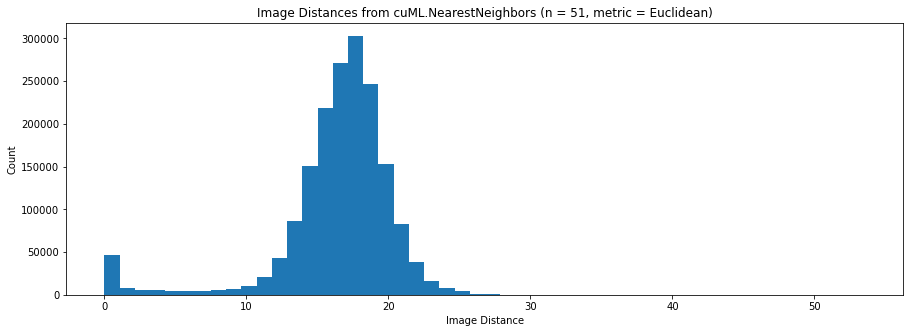

In [15]:
# Check distribution of image distances from cuML.NearestNeighbors (n = 51, metric = Euclidean)
plt.figure(figsize=(15,5))
plt.hist(all_image_distances, bins = 50)
plt.xlabel('Image Distance')
plt.ylabel('Count')
plt.title('Image Distances from cuML.NearestNeighbors (n = 51, metric = Euclidean)');

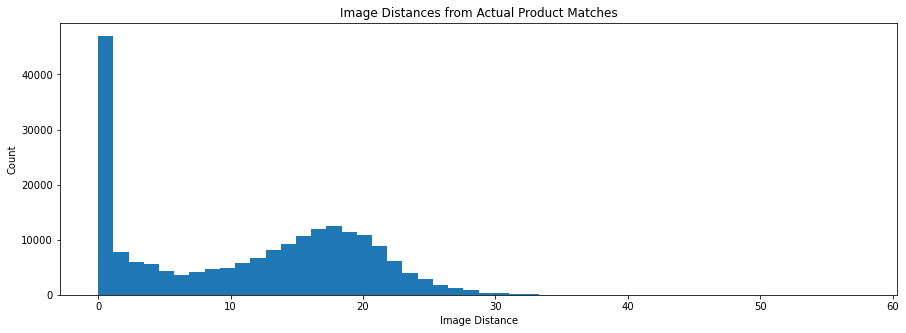

In [16]:
# Check distribution of actual matches image distances distribution
plt.figure(figsize=(15,5))
plt.hist(np.concatenate(actual_image_distances), bins = 50)
plt.xlabel('Image Distance')
plt.ylabel('Count')
plt.title('Image Distances from Actual Product Matches');

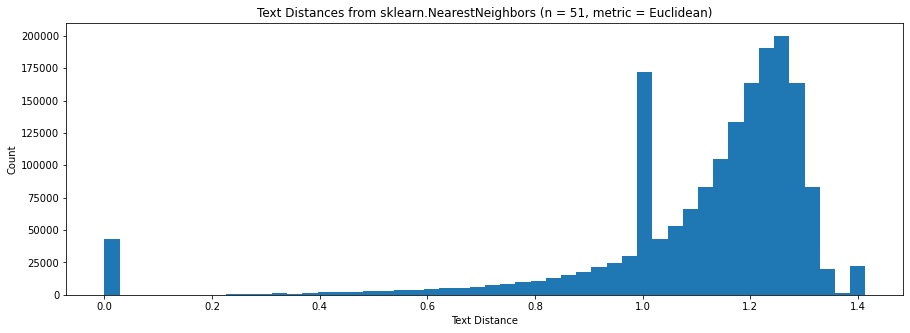

In [17]:
# Check distribution of text distances from sklearn.NearestNeighbors (n = 51, metric = Euclidean)
plt.figure(figsize=(15,5))
plt.hist(all_text_distances, bins = 50)
plt.xlabel('Text Distance')
plt.ylabel('Count')
plt.title('Text Distances from sklearn.NearestNeighbors (n = 51, metric = Euclidean)');

Predicted text distances of 1.0 are when the product titles of the neighbours consist solely of stop words, i.e. they have no tokens.

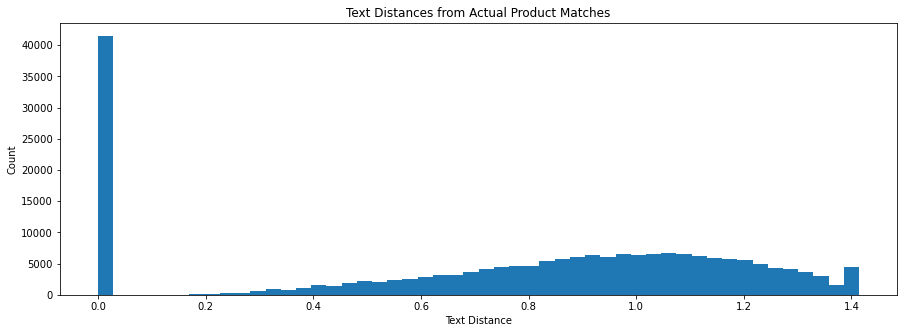

In [18]:
# Check distribution of actual matches text distances distribution
plt.figure(figsize=(15,5))
plt.hist(np.concatenate(actual_text_distances), bins = 50)
plt.xlabel('Text Distance')
plt.ylabel('Count')
plt.title('Text Distances from Actual Product Matches');

### F1 Scores = 1

In [265]:
view = ['posting_id', 'title', 'matches', 'combined_preds_0', 'combined_scores_0',
        'match_image_distances', 'match_text_distances', 'pred_image_distances', 'pred_text_distances',
        'pred_image_distances_avg', 'pred_text_distances_avg']

In [266]:
# Explore products with combined scores = 1
train.loc[train['combined_scores_0'] == 1][view].head(10)

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,match_image_distances,match_text_distances,pred_image_distances,pred_text_distances,pred_image_distances_avg,pred_text_distances_avg
0,train_129225211,Paper Bag Victoria Secret,"[train_129225211, train_2278313361]",[train_129225211],"[train_129225211, train_2278313361]",1.0,"[0.0, 20.14]","[0.0, 0.0]","[0.0, 18.38, 18.47, 18.68, 18.99, 19.07, 19.08...","[0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.015, 1.015, 1...",19.160000,1.155
2,train_2288590299,Maling TTS Canned Pork Luncheon Meat 397 gr,"[train_2288590299, train_3803689425]",[train_2288590299],"[train_2288590299, train_3803689425]",1.0,"[0.0, 23.25]","[0.0, 0.808]","[0.02, 18.94, 19.39, 19.46, 19.56, 19.7, 19.73...","[0.0, 0.808, 1.0, 1.0, 1.0, 1.0, 1.254, 1.274,...",20.459999,1.299
4,train_3369186413,Nescafe \xc3\x89clair Latte 220ml,"[train_3369186413, train_921438619]",[train_3369186413],"[train_3369186413, train_921438619]",1.0,"[0.0, 8.55]","[0.0, 1.142]","[0.0, 8.55, 12.45, 12.77, 12.95, 13.36, 13.57,...","[0.0, 1.0, 1.0, 1.0, 1.0, 1.142, 1.162, 1.217,...",14.330000,1.222
10,train_1598329973,Atasan Rajut Wanita LISDIA SWEATER,"[train_1598329973, train_841015183, train_4224...",[train_1598329973],"[train_1598329973, train_4224502769, train_841...",1.0,"[0.0, 14.86, 14.86]","[0.0, 0.0, 0.405]","[0.03, 12.85, 14.06, 14.2, 14.21, 14.26, 14.56...","[0.0, 0.0, 0.405, 0.982, 1.0, 1.0, 1.0, 1.0, 1...",15.110000,1.055
11,train_2496690777,PASHMINA KUSUT RAWIS POLOS CRINKLE SHAWL MURAH...,"[train_2496690777, train_2771755203, train_163...","[train_2496690777, train_2771755203]","[train_1638187876, train_2496690777, train_277...",1.0,"[0.0, 0.0, 27.52]","[0.0, 0.299, 0.808]","[0.0, 0.0, 21.54, 21.67, 21.89, 22.02, 22.09, ...","[0.0, 0.299, 0.808, 1.0, 1.0, 1.0, 1.0, 1.013,...",22.129999,1.173
12,train_2771755203,PASHMINA KUSUT RAWIS POLOS CRINKLE SHAWL MURAH...,"[train_2496690777, train_2771755203, train_163...","[train_2496690777, train_2771755203]","[train_1638187876, train_2496690777, train_277...",1.0,"[0.0, 0.0, 27.52]","[0.299, 0.0, 0.844]","[0.0, 0.0, 21.54, 21.67, 21.89, 22.02, 22.09, ...","[0.0, 0.299, 0.844, 0.953, 1.0, 1.0, 1.0, 1.0,...",22.129999,1.166
14,train_4287573913,Charger VIZZ VZ-TC11 / batok charger vizz 1A O...,"[train_4287573913, train_1748125201, train_163...","[train_4287573913, train_1748125201, train_163...","[train_1633622311, train_1748125201, train_428...",1.0,"[0.0, 0.72, 0.72]","[0.0, 0.811, 0.797]","[0.02, 0.72, 0.72, 13.66, 14.75, 14.87, 14.95,...","[0.0, 0.797, 0.811, 1.0, 1.0, 1.0, 1.0, 1.098,...",15.920000,1.200
17,train_3054371232,"Saffron 0,25 gr s.d 2 gr Super Negin Premium Q...","[train_3054371232, train_2301578474]",[train_3054371232],"[train_2301578474, train_3054371232]",1.0,"[0.0, 16.94]","[0.0, 0.584]","[0.03, 16.94, 18.55, 18.66, 19.04, 19.56, 19.7...","[0.0, 0.584, 0.933, 1.0, 1.0, 1.0, 1.0, 1.071,...",19.889999,1.188
18,train_2985955659,HnKfashion Sweater Hoodie WHO Printing BabyTer...,"[train_2985955659, train_3916258742, train_415...",[train_2985955659],"[train_2985955659, train_3916258742, train_415...",1.0,"[0.0, 2.6, 2.52]","[0.0, 1.041, 1.041]","[0.0, 2.51, 2.6, 15.01, 15.02, 15.18, 15.51, 1...","[0.0, 1.0, 1.0, 1.0, 1.0, 1.041, 1.041, 1.078,...",15.900000,1.134
20,train_999391364,Safi Dermasafe Night Moisturiser 50 gr,"[train_999391364, train_4285884352]",[train_999391364],"[train_4285884352, train_999391364]",1.0,"[0.0, 13.54]","[0.0, 0.872]","[0.02, 13.28, 13.3, 13.54, 13.6, 13.64, 13.69,...","[0.0, 0.872, 1.0, 1.0, 1.0, 1.0, 1.16, 1.177, ...",14.130000,1.215


## Prediction Heuristics

Currently, the best image predictions use a fixed distance threshold of 11. The best text predictions use a fixed threshold of 0.9.

Possible heuristics to combine image and text embeddings to improve predictions:

- Density based:
    - Set different distance thresholds for each product, based on the distances of the nearest neighbours. If the average distance of the nearest neighbours is smaller, use a smaller threshold.
- Sequential filtering:
    - Find similar images first, then find similar titles within these images
    - Find similar titles first, then find similar images within these titles
- Default to 1:
    - Most products are in pairs, and thus most predictions should be of size 2. If the nearest neighbour is above a certain threshold, meaning it is not similar enough, predict just 1 product (the product itself). This gives a default F1 score of 0.667 (predicting 1 out of 2) instead of a low score if too many products are predicted.
- Pair unpaired products:
    - If only 1 product is predicted (the product itself), there must be at least 1 other product that is the same because the minimum group size is 2. If only 1 product is predicted, try searching other predictions with only 1 product for a possible match (i.e. try to pair the predictions with only 1 product).

### Heuristic 1

Density-based distance heuristic:
- If the average image/text distance is lower, use a lower distance threshold
- If the average image/text distance is higher, use a higher distance threshold
- Set distance threshold to be a percentage of average image/text distance
- Use set union of final image/text predictions

In [19]:
# Check the average image distance of the 50 nearest image neighbours
np.mean([np.mean(i) for i in image_distances])

0.39890698

In [20]:
# Check the average text distance of the 50 nearest text neighbours
np.mean([np.mean(i) for i in text_distances])

0.678338417852965

In [21]:
# Check ratio of current fixed image threshold (0.2333) against average image distance
0.2333 / 0.39890698

0.5848481267487473

In [22]:
# Check ratio of current fixed text threshold (0.4333) against average text distance
0.4333 / 0.678338417852965

0.6387667108276935

In [23]:
# Set default image and text distance ratios
image_ratio = 0.58
text_ratio = 0.64

In [24]:
# Create function to predict based on image and text distances.
# Returns image predictions, text predictions and set union predictions
def predict_1(df, image_distances, image_indices, text_distances, text_indices, image_ratio, text_ratio):
    image_preds = []
    text_preds = []
    preds_union = []

    for i in range(df.shape[0]):
        
        # Set image threshold based on ratio of average image distance
        image_threshold = image_ratio * np.mean(image_distances[i])
        image_idx = image_indices[i][np.where(image_distances[i] <= image_threshold)]
        image_ids = df['posting_id'].iloc[image_idx].values
        image_preds.append(image_ids)
        
        # Set text threshold based on ratio of average text distance
        text_threshold = text_ratio * np.mean(text_distances[i])
        
        # Exclude text distances of 1 also
        text_idx = text_indices[i][(np.where((text_distances[i] <= text_threshold) & (text_distances[i] != 1)))]
        text_ids = df['posting_id'].iloc[text_idx].values
        text_preds.append(text_ids)
        
        preds_union.append(np.union1d(image_ids, text_ids))

    return image_preds, text_preds, preds_union

In [25]:
# Create predictions from default image and text distance ratios
image_preds_1, text_preds_1, preds_union_1 = predict_1(train, image_distances, image_indices, text_distances, text_indices, image_ratio, text_ratio)

In [26]:
matches = list(train['matches'].to_numpy())

In [27]:
# Check average F1 score of image predictions from default ratios
np.mean(scores(matches, image_preds_1))

0.7114339775022952

In [28]:
# Check average F1 score of text predictions from default ratios
np.mean(scores(matches, text_preds_1))

0.6585770734299018

In [29]:
# Check average F1 score of set union predictions from default ratios
np.mean(scores(matches, preds_union_1))

0.7627802848312543

In [30]:
# Grid search various image and text ratios
image_ratios = [0.54, 0.56, 0.58, 0.60, 0.62]
text_ratios = [0.60, 0.62, 0.64, 0.66, 0.68]

for image_ratio in image_ratios:
    for text_ratio in text_ratios:
        image_preds_search, text_preds_search, preds_union_search = predict_1(train, image_distances, image_indices, 
                                                                              text_distances, text_indices, 
                                                                              image_ratio, text_ratio)
        print(f'At image ratio {image_ratio} and text ratio {text_ratio}:')
        print(f'average image prediction score is {np.mean(scores(matches, image_preds_search))}')
        print(f'average text prediction score is {np.mean(scores(matches, text_preds_search))}')
        print(f'average union prediction score is {np.mean(scores(matches, preds_union_search))}')

At image ratio 0.54 and text ratio 0.6:
average image prediction score is 0.7051972347747928
average text prediction score is 0.6555280834254488
average union prediction score is 0.7678225310429823
At image ratio 0.54 and text ratio 0.62:
average image prediction score is 0.7051972347747928
average text prediction score is 0.6572090003178892
average union prediction score is 0.7650395513163242
At image ratio 0.54 and text ratio 0.64:
average image prediction score is 0.7051972347747928
average text prediction score is 0.6585770734299018
average union prediction score is 0.7615334370066659
At image ratio 0.54 and text ratio 0.66:
average image prediction score is 0.7051972347747928
average text prediction score is 0.659044277161936
average union prediction score is 0.7571957038343645
At image ratio 0.54 and text ratio 0.68:
average image prediction score is 0.7051972347747928
average text prediction score is 0.6580662129710481
average union prediction score is 0.7519120618528393
At imag

In [31]:
# Image scores are still increasing at 0.62 image ratio. Try more values
image_ratios = [0.64, 0.66, 0.68, 0.70, 0.72]
text_ratios = [0.60, 0.62, 0.64, 0.66, 0.68]

for image_ratio in image_ratios:
    for text_ratio in text_ratios:
        image_preds_search, text_preds_search, preds_union_search = predict_1(train, image_distances, image_indices, 
                                                                              text_distances, text_indices, 
                                                                              image_ratio, text_ratio)
        print(f'At image ratio {image_ratio} and text ratio {text_ratio}:')
        print(f'average image prediction score is {np.mean(scores(matches, image_preds_search))}')
        print(f'average text prediction score is {np.mean(scores(matches, text_preds_search))}')
        print(f'average union prediction score is {np.mean(scores(matches, preds_union_search))}')

At image ratio 0.64 and text ratio 0.6:
average image prediction score is 0.7179023163318293
average text prediction score is 0.6555280834254488
average union prediction score is 0.7688895359456145
At image ratio 0.64 and text ratio 0.62:
average image prediction score is 0.7179023163318293
average text prediction score is 0.6572090003178892
average union prediction score is 0.7659617693588525
At image ratio 0.64 and text ratio 0.64:
average image prediction score is 0.7179023163318293
average text prediction score is 0.6585770734299018
average union prediction score is 0.7622106994186761
At image ratio 0.64 and text ratio 0.66:
average image prediction score is 0.7179023163318293
average text prediction score is 0.659044277161936
average union prediction score is 0.7576449026129511
At image ratio 0.64 and text ratio 0.68:
average image prediction score is 0.7179023163318293
average text prediction score is 0.6580662129710481
average union prediction score is 0.7522182643319413
At imag

In [32]:
# Best combination: image ratio 0.62 and text ratio 0.6 gives score of 0.7695809959680939
# Create predictions from best image and text distance ratios
image_preds_1, text_preds_1, preds_union_1 = predict_1(train, image_distances, image_indices, text_distances, text_indices,
                                                       0.62, 0.6)

In [33]:
# Save best results to df
train['best_image_preds_1'] = image_preds_1
train['best_image_scores_1'] = scores(matches,image_preds_1)

train['best_text_preds_1'] = text_preds_1
train['best_text_scores_1'] = scores(matches,text_preds_1)

train['combined_preds_1'] = preds_union_1
train['combined_scores_1'] = scores(matches,preds_union_1)

In [34]:
# Save combined train dataset as npy
np.save('../datasets/train_combined.npy', train.to_numpy())

In [35]:
# Print columns for reloading np file
print(train.columns)

Index(['posting_id', 'image', 'image_phash', 'title', 'label_group', 'matches',
       'image_duplicates', 'best_image_preds_0', 'best_image_scores_0',
       'best_text_preds_0', 'best_text_scores_0', 'combined_preds_0',
       'combined_scores_0', 'best_image_preds_1', 'best_image_scores_1',
       'best_text_preds_1', 'best_text_scores_1', 'combined_preds_1',
       'combined_scores_1'],
      dtype='object')


## Scores and Results

### Distribution of F1 Scores

In [36]:
# Load combined train df
train = pd.DataFrame(np.load('../datasets/train_combined.npy', allow_pickle=True),
                      columns=['posting_id', 'image', 'image_phash', 'title', 'label_group', 'matches',
                               'image_duplicates', 'best_image_preds_0', 'best_image_scores_0',
                               'best_text_preds_0', 'best_text_scores_0', 'combined_preds_0',
                               'combined_scores_0', 'best_image_preds_1', 'best_image_scores_1',
                               'best_text_preds_1', 'best_text_scores_1', 'combined_preds_1',
                               'combined_scores_1'])

In [37]:
train.head()

,posting_id,image,image_phash,title,label_group,matches,image_duplicates,best_image_preds_0,best_image_scores_0,best_text_preds_0,best_text_scores_0,combined_preds_0,combined_scores_0,best_image_preds_1,best_image_scores_1,best_text_preds_1,best_text_scores_1,combined_preds_1,combined_scores_1
0,train_129225211,0000a68812bc7e98c42888dfb1c07da0.jpg,94974f937d4c2433,Paper Bag Victoria Secret,249114794,"[train_129225211, train_2278313361]",[train_129225211],[train_129225211],0.666667,"[train_129225211, train_2278313361]",1.0,"[train_129225211, train_2278313361]",1.0,[train_129225211],0.666667,"[train_129225211, train_2278313361]",1.0,"[train_129225211, train_2278313361]",1.0
1,train_3386243561,00039780dfc94d01db8676fe789ecd05.jpg,af3f9460c2838f0f,"Double Tape 3M VHB 12 mm x 4,5 m ORIGINAL / DO...",2937985045,"[train_3386243561, train_3423213080]",[train_3386243561],"[train_3386243561, train_3423213080, train_212...",0.5,"[train_3386243561, train_3423213080, train_197...",0.5,"[train_1816968361, train_1974987067, train_211...",0.333333,"[train_3386243561, train_3423213080, train_212...",0.5,[train_3386243561],0.666667,"[train_1816968361, train_2120597446, train_250...",0.5
2,train_2288590299,000a190fdd715a2a36faed16e2c65df7.jpg,b94cb00ed3e50f78,Maling TTS Canned Pork Luncheon Meat 397 gr,2395904891,"[train_2288590299, train_3803689425]",[train_2288590299],[train_2288590299],0.666667,"[train_2288590299, train_3803689425]",1.0,"[train_2288590299, train_3803689425]",1.0,[train_2288590299],0.666667,"[train_2288590299, train_3803689425]",1.0,"[train_2288590299, train_3803689425]",1.0
3,train_2406599165,00117e4fc239b1b641ff08340b429633.jpg,8514fc58eafea283,Daster Batik Lengan pendek - Motif Acak / Camp...,4093212188,"[train_2406599165, train_3342059966]",[train_2406599165],"[train_2406599165, train_1593362411, train_280...",0.333333,"[train_1744956981, train_2406599165, train_352...",0.222222,"[train_1508100548, train_1593362411, train_174...",0.166667,"[train_2406599165, train_1593362411]",0.5,"[train_1744956981, train_2406599165, train_352...",0.25,"[train_1508100548, train_1593362411, train_174...",0.222222
4,train_3369186413,00136d1cf4edede0203f32f05f660588.jpg,a6f319f924ad708c,Nescafe \xc3\x89clair Latte 220ml,3648931069,"[train_3369186413, train_921438619]",[train_3369186413],"[train_3369186413, train_921438619]",1.0,[train_3369186413],0.666667,"[train_3369186413, train_921438619]",1.0,"[train_3369186413, train_921438619]",1.0,[train_3369186413],0.666667,"[train_3369186413, train_921438619]",1.0


In [38]:
# Combined models to examine
models = [0, 1]

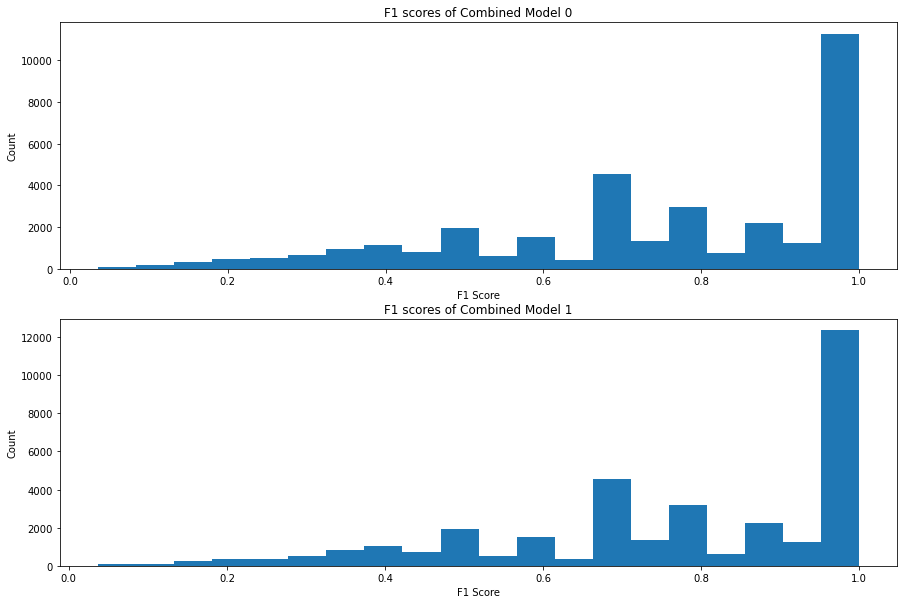

In [39]:
# Check distribution of F1 scores
plt.figure(figsize=(15,5*len(models)))

for i in range(len(models)):
    plt.subplot(len(models), 1, i + 1)
    plt.hist(train[f'combined_scores_{models[i]}'], bins=20)
    plt.ylabel('Count')
    plt.xlabel('F1 Score')
    plt.title(f'F1 scores of Combined Model {models[i]}')

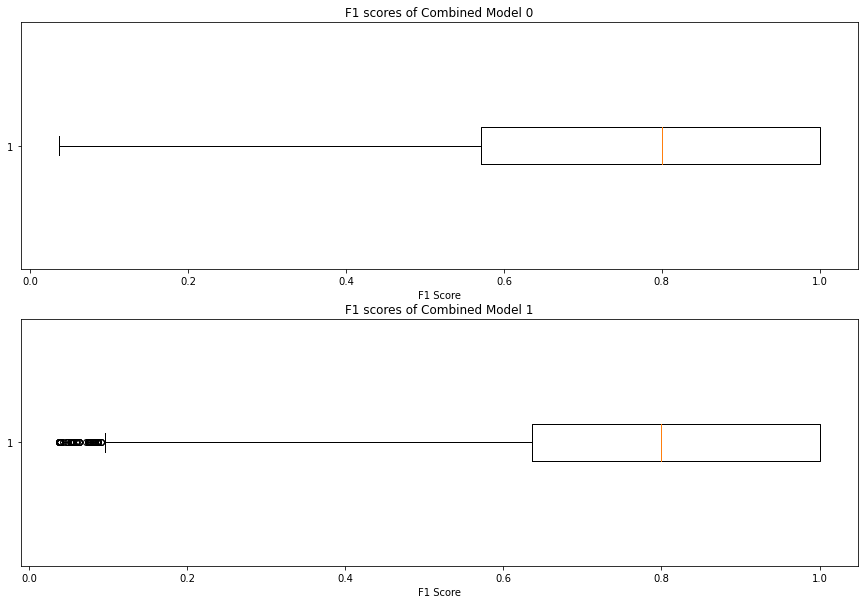

In [40]:
# Check distribution of F1 scores
plt.figure(figsize=(15,5*len(models)))

for i in range(len(models)):
    plt.subplot(len(models), 1, i + 1)
    plt.boxplot(train[f'combined_scores_{models[i]}'], vert=False)
    plt.xlabel('F1 Score')
    plt.title(f'F1 scores of Combined Model {models[i]}');

In [41]:
# Check F1 score value counts
for i in range(len(models)):
    print(f'Most frequent F1 score of combined model {models[i]}')
    print(train[f'combined_scores_{models[i]}'].value_counts().head(10))
    print('')

Most frequent F1 score of combined model 0
1.000000    10857
0.666667     4245
0.800000     2442
0.500000     1784
0.857143     1039
0.571429      977
0.400000      918
0.750000      671
0.888889      645
0.333333      539
Name: combined_scores_0, dtype: int64

Most frequent F1 score of combined model 1
1.000000    12036
0.666667     4332
0.800000     2771
0.500000     1768
0.857143     1106
0.571429      975
0.400000      882
0.750000      759
0.888889      719
0.333333      505
Name: combined_scores_1, dtype: int64



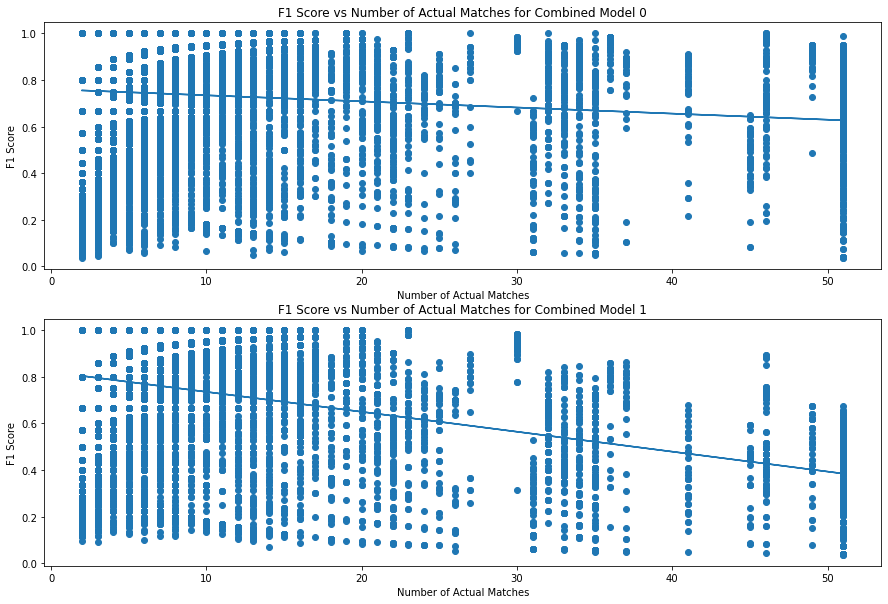

In [42]:
# Check F1 scores by number of matches
plt.figure(figsize = (15,5*len(models)))
x = [(len(match)) for match in train['matches']]

for i in range(len(models)):
    y = train[f'combined_scores_{models[i]}'].astype('float64')
    plt.subplot(len(models), 1, i + 1)
    plt.scatter(x, y)
    m, b = np.polyfit(x, y, 1)
    plt.plot(x, [m*i for i in x] + b)
    plt.xlabel('Number of Actual Matches')
    plt.ylabel('F1 Score')
    plt.title(f'F1 Score vs Number of Actual Matches for Combined Model {models[i]}');

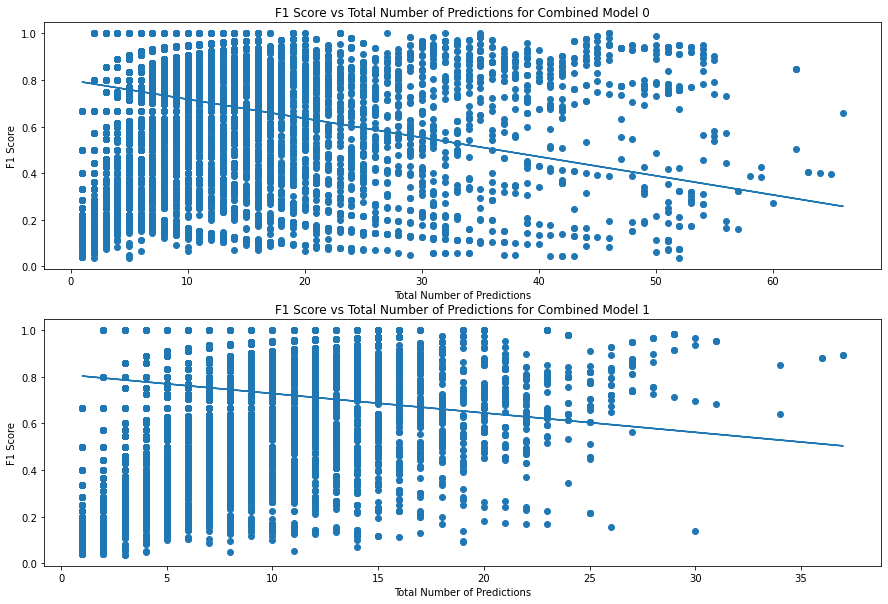

In [43]:
# Check F1 scores by number of predictions
plt.figure(figsize = (15,5*len(models)))

for i in range(len(models)):
    x = [len(pred) for pred in train[f'combined_preds_{models[i]}']]
    y = train[f'combined_scores_{models[i]}'].astype('float64')
    plt.subplot(len(models), 1, i + 1)
    plt.scatter(x, y)
    m, b = np.polyfit(x, y, 1)
    plt.plot(x, [m*i for i in x] + b)
    plt.xlabel('Total Number of Predictions')
    plt.ylabel('F1 Score')
    plt.title(f'F1 Score vs Total Number of Predictions for Combined Model {models[i]}');

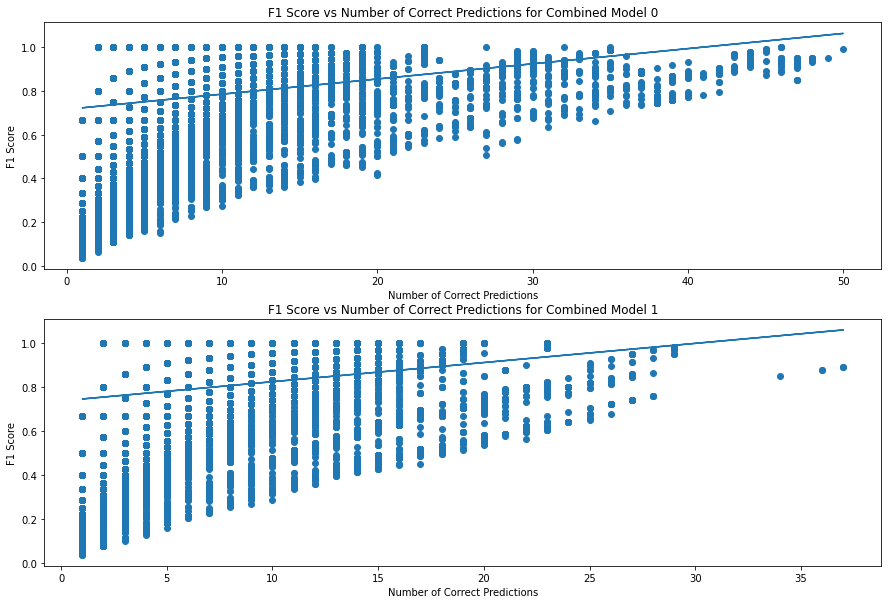

In [44]:
# Check F1 scores by number of correct predictions
plt.figure(figsize = (15,5*len(models)))

for i in range(len(models)):
    x = []
    for j in range(len(train['matches'])):
        x.append(len(np.intersect1d(train['matches'][j], train[f'combined_preds_{models[i]}'][j])))
    y = train[f'combined_scores_{models[i]}'].astype('float64')
    plt.subplot(len(models), 1, i + 1)
    plt.scatter(x, y)
    m, b = np.polyfit(x, y, 1)
    plt.plot(x, [m*i for i in x] + b)
    plt.xlabel('Number of Correct Predictions')
    plt.ylabel('F1 Score')
    plt.title(f'F1 Score vs Number of Correct Predictions for Combined Model {models[i]}');

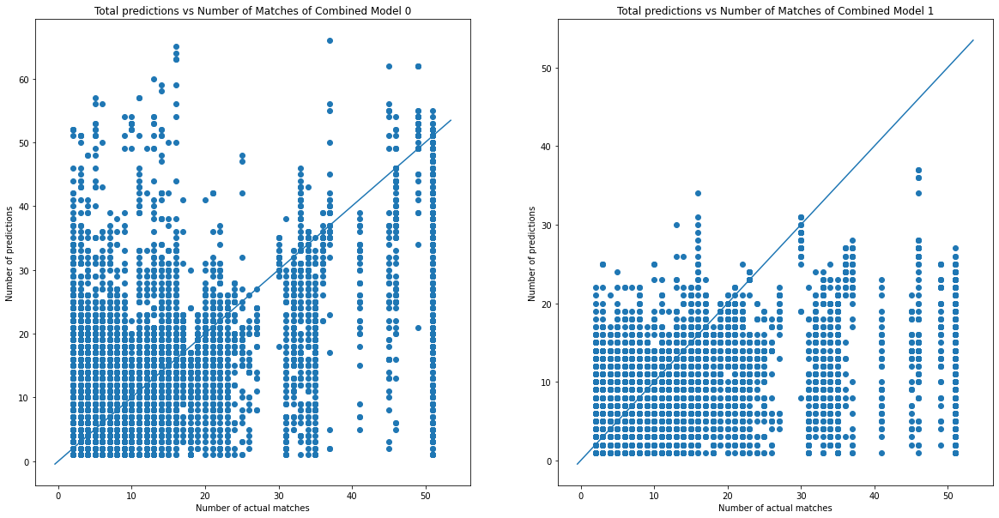

In [45]:
# Check number of predictions vs number of matches
plt.figure(figsize=(20,10))
x = [(len(match)) for match in train['matches']]

for i in range(len(models)):
    y = [len(pred) for pred in train[f'combined_preds_{models[i]}']]
    plt.subplot(1,2,i+1)
    plt.scatter(x, y)
    xpoints = ypoints = plt.xlim()
    plt.plot(xpoints, ypoints)
    plt.xlabel('Number of actual matches')
    plt.ylabel('Number of predictions')
    plt.title(f'Total predictions vs Number of Matches of Combined Model {models[i]}');

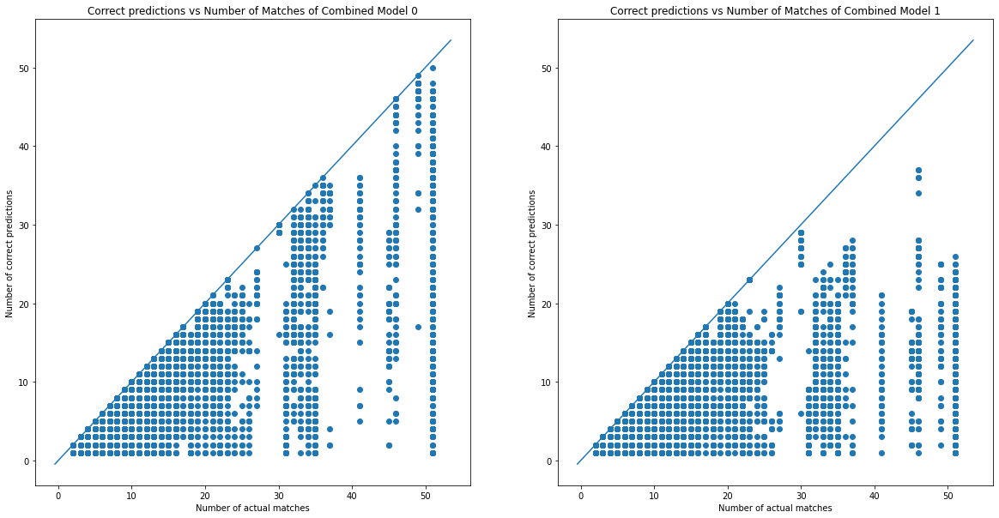

In [46]:
# Check number of correct predictions vs number of matches
plt.figure(figsize=(20,10))
x = [(len(match)) for match in train['matches']]

for i in range(len(models)):
    y = []
    for j in range(len(train['matches'])):
        y.append(len(np.intersect1d(train['matches'][j], train[f'combined_preds_{models[i]}'][j])))
    plt.subplot(1,2,i+1)
    plt.scatter(x, y)
    xpoints = ypoints = plt.xlim()
    plt.plot(xpoints, ypoints)
    plt.xlabel('Number of actual matches')
    plt.ylabel('Number of correct predictions')
    plt.title(f'Correct predictions vs Number of Matches of Combined Model {models[i]}');

### Combined Predictions vs Image/Text Predictions

In [52]:
# Create function to compare combined predictions vs image / text predictions alone
def compare(df, model):
    comparisons = []
    
    for i in range(train.shape[0]):
        if (train[f'combined_scores_{model}'].iloc[i] >= train[f'best_image_scores_{model}'].iloc[i]) and \
           (train[f'combined_scores_{model}'].iloc[i] >= train[f'best_text_scores_{model}'].iloc[i]):
            comparisons.append('combined better than / equal to image and text')

        elif (train[f'combined_scores_{model}'].iloc[i] < train[f'best_image_scores_{model}'].iloc[i]) and \
             (train[f'combined_scores_{model}'].iloc[i] < train[f'best_text_scores_{model}'].iloc[i]):
            comparisons.append('combined worse than image and text')

        elif (train[f'combined_scores_{model}'].iloc[i] >= train[f'best_image_scores_{model}'].iloc[i]) and \
             (train[f'combined_scores_{model}'].iloc[i] < train[f'best_text_scores_{model}'].iloc[i]):
            comparisons.append('combined better than / equal to image but worse than text')

        elif (train[f'combined_scores_{model}'].iloc[i] >= train[f'best_text_scores_{model}'].iloc[i]) and \
             (train[f'combined_scores_{model}'].iloc[i] < train[f'best_image_scores_{model}'].iloc[i]):
            comparisons.append('combined better than / equal to text but worse than image')
    
    return comparisons

In [53]:
# Check comparisons for model 0
nltk.FreqDist(compare(train, model=0)).most_common()

[('combined better than / equal to image and text', 23378),
 ('combined better than / equal to text but worse than image', 7606),
 ('combined better than / equal to image but worse than text', 2355),
 ('combined worse than image and text', 911)]

In [54]:
# Check comparisons for model 1
nltk.FreqDist(compare(train, model=1)).most_common()

[('combined better than / equal to image and text', 25792),
 ('combined better than / equal to text but worse than image', 6076),
 ('combined better than / equal to image but worse than text', 1811),
 ('combined worse than image and text', 571)]

Set union of best image and text predictions generally improves or retains the image/text scores.

However, some scores were lower after using the set union. In particular, some set union scores were lower than the image scores.

### Image and Title Predictions vs Matches

In [55]:
# Create function to plot images of matches or combined predictions
def show_images_combined(df, posting_id, model=0, matches=True, columns=3, width=30, height=10):
    
    # If we are checking for matching images
    if matches:
        group = df.loc[df['posting_id'] == posting_id]['matches'].values[0]

    # If we are checking our combined predictions
    else:
        group = df.loc[df['posting_id'] == posting_id][f'combined_preds_{model}'].values[0]

    height = max(height, int(len(group)/columns) * height)
    plt.figure(figsize=(width, height))

    for i in range(len(group)):
        plt.subplot(len(group) // columns + 1, columns, i + 1)
        im = Image.open(train_dir + '/' + df.loc[df['posting_id'] == group[i]]['image'].values[0])
        plt.imshow(im)
        plt.title(df.loc[df['posting_id'] == group[i]]['title'].values[0])

In [67]:
view = ['posting_id', 'title', 'matches', 'image_duplicates',
        'combined_preds_0', 'combined_scores_0',
        'combined_preds_1', 'combined_scores_1']

#### Model 1 > Model 0

In [68]:
# Check predictions where model 1 is better than model 0
train.loc[train['combined_scores_0'] < train['combined_scores_1']][view].head()

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1
1,train_3386243561,"Double Tape 3M VHB 12 mm x 4,5 m ORIGINAL / DO...","[train_3386243561, train_3423213080]",[train_3386243561],"[train_1816968361, train_1974987067, train_211...",0.363636,"[train_1816968361, train_2120597446, train_338...",0.571429
3,train_2406599165,Daster Batik Lengan pendek - Motif Acak / Camp...,"[train_2406599165, train_3342059966]",[train_2406599165],"[train_1508100548, train_1593362411, train_174...",0.166667,"[train_1508100548, train_1744956981, train_204...",0.25
26,train_2905529497,Masker Medis 3ply Earloop (50pcs) - Masker 3pl...,"[train_2905529497, train_869563964]",[train_2905529497],"[train_109788017, train_1166693195, train_1782...",0.181818,"[train_1918073967, train_2905529497, train_856...",0.4
28,train_1572286671,Pakaian Dalam Cewek Wings Bra Bra Tempel Seam...,"[train_1572286671, train_3117535609, train_321...","[train_1572286671, train_3117535609, train_321...","[train_134322313, train_1572286671, train_1685...",0.6,"[train_1572286671, train_3117535609, train_321...",1.0
29,train_3117535609,WINGs BRA-BRA TEMPEL SEAMLESS - PUSH UP BRA - ...,"[train_1572286671, train_3117535609, train_321...","[train_1572286671, train_3117535609, train_321...","[train_1572286671, train_1685481950, train_311...",0.6,"[train_1572286671, train_3117535609, train_321...",1.0


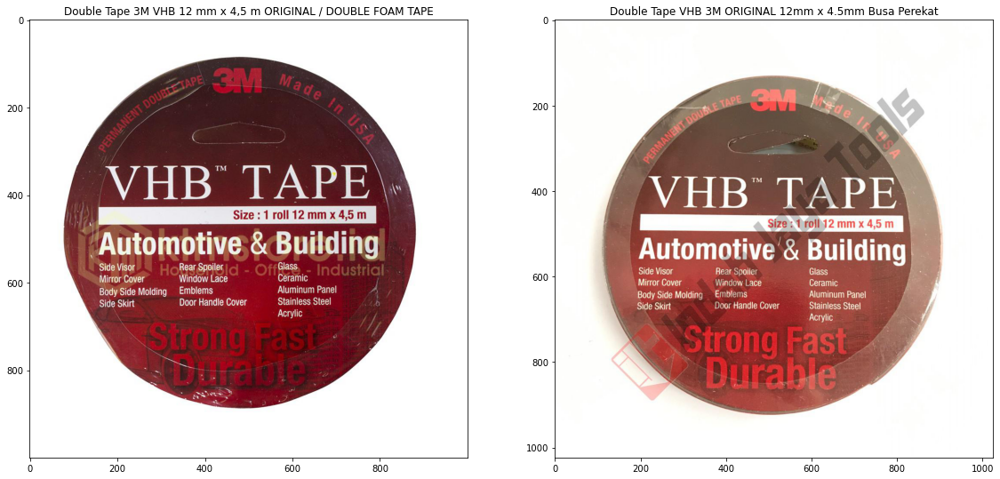

In [57]:
# Show matching images and titles of 'train_3386243561'
show_images_combined(train, 'train_3386243561', matches=True)

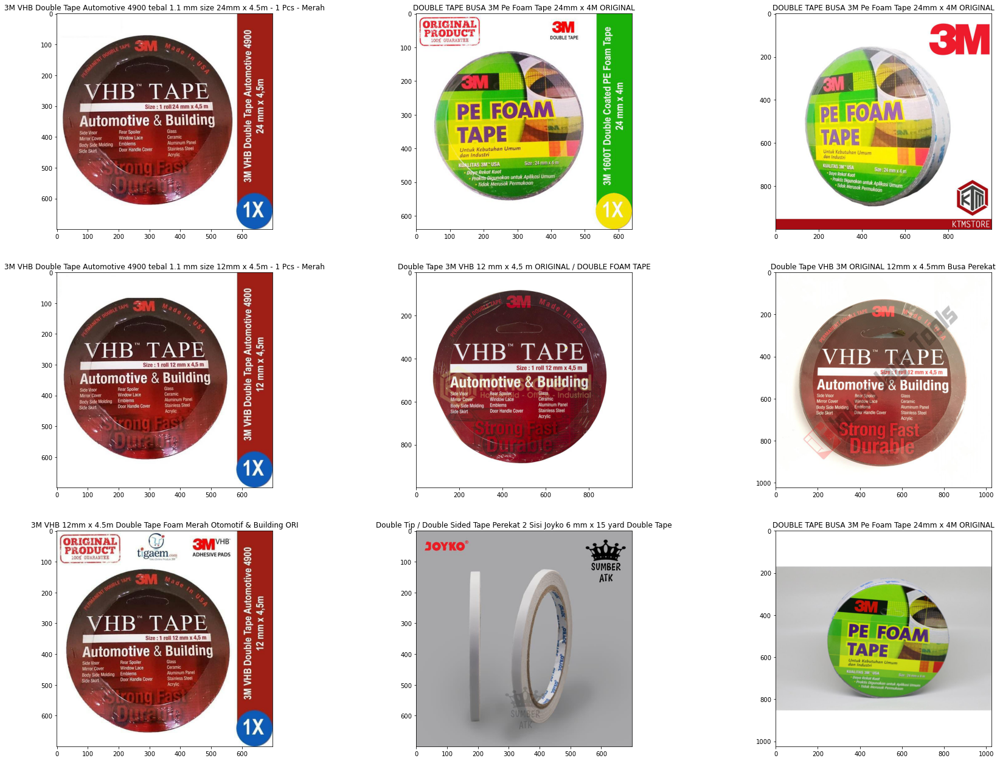

In [58]:
# Show predicted images and titles of 'train_3386243561' from model 0
show_images_combined(train, 'train_3386243561', model=0, matches=False)

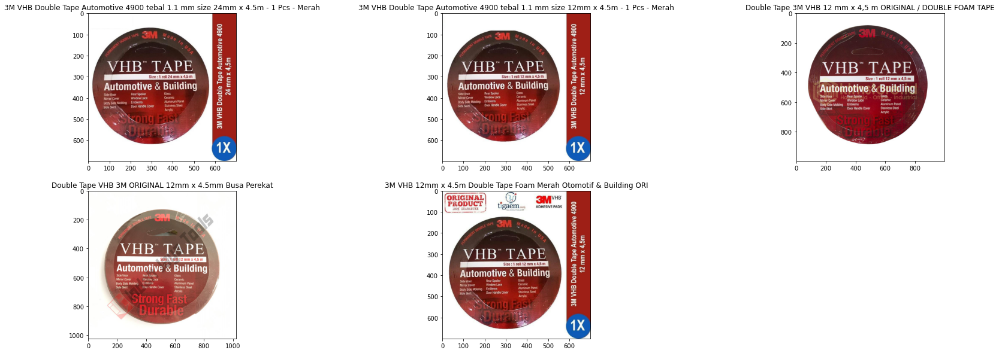

In [59]:
# Show predicted images and titles of 'train_3386243561' from model 1
show_images_combined(train, 'train_3386243561', model=1, matches=False)

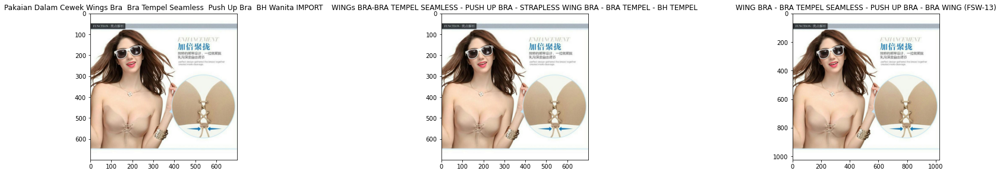

In [69]:
# Show matching images and titles of 'train_1572286671'
show_images_combined(train, 'train_1572286671', matches=True)

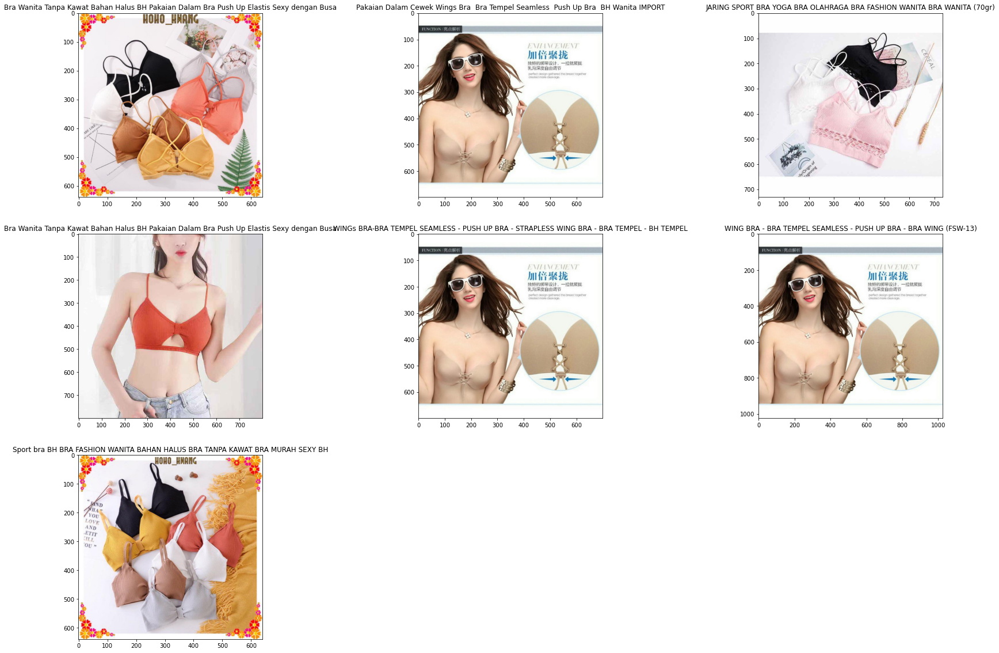

In [70]:
# Show predicted images and titles of 'train_1572286671' from model 0
show_images_combined(train, 'train_1572286671', model=0, matches=False)

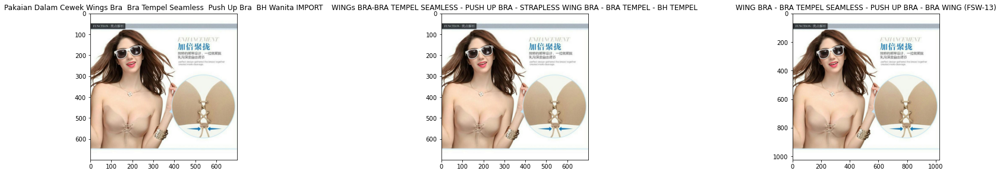

In [71]:
# Show predicted images and titles of 'train_1572286671' from model 1
show_images_combined(train, 'train_1572286671', model=1, matches=False)

#### F1 Scores < 0.66

F1 scores of 1.0, 0.667 and 0.8 are most common. Examine images / titles of predictions with scores < 0.66.

In [72]:
# Check predictions where model 0 and model 1 < 0.66
train.loc[((train['combined_scores_0'] < 0.66) & (train['combined_scores_1'] < 0.66))][view].head(10)

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1
1,train_3386243561,"Double Tape 3M VHB 12 mm x 4,5 m ORIGINAL / DO...","[train_3386243561, train_3423213080]",[train_3386243561],"[train_1816968361, train_1974987067, train_211...",0.363636,"[train_1816968361, train_2120597446, train_338...",0.571429
3,train_2406599165,Daster Batik Lengan pendek - Motif Acak / Camp...,"[train_2406599165, train_3342059966]",[train_2406599165],"[train_1508100548, train_1593362411, train_174...",0.166667,"[train_1508100548, train_1744956981, train_204...",0.25
6,train_1802986387,Jubah anak size 1-12 thn,"[train_1802986387, train_1396161074, train_713...",[train_1802986387],"[train_1396161074, train_1513994777, train_180...",0.545455,"[train_1396161074, train_1513994777, train_180...",0.4
15,train_4196427721,Korek Kuping LED untuk balita CherryBabyKidsSh...,"[train_4196427721, train_1482447822, train_234...","[train_4196427721, train_2221959828, train_375...","[train_2221959828, train_3757879175, train_419...",0.545455,"[train_2221959828, train_3757879175, train_419...",0.545455
16,train_3009013664,MARKS & SPENCER - Rose Hand & Body Lotion 250 ml,"[train_3009013664, train_3448377589]",[train_3009013664],"[train_1248209230, train_2047191940, train_236...",0.5,"[train_1248209230, train_2047191940, train_236...",0.5
26,train_2905529497,Masker Medis 3ply Earloop (50pcs) - Masker 3pl...,"[train_2905529497, train_869563964]",[train_2905529497],"[train_109788017, train_1166693195, train_1782...",0.181818,"[train_1918073967, train_2905529497, train_856...",0.4
30,train_1617041019,Molina Kaftan / YADITA SPARKLE KAFTAN / KEANU ...,"[train_1617041019, train_2772927896]",[train_1617041019],"[train_1210102540, train_1617041019, train_176...",0.5,"[train_1210102540, train_1617041019, train_176...",0.5
31,train_2410183091,B33F My Food Shop Shopping Trolley - ST. 003 t...,"[train_2410183091, train_2529718493, train_304...",[train_2410183091],"[train_143394667, train_1504499709, train_2410...",0.571429,"[train_143394667, train_1504499709, train_2410...",0.571429
35,train_1640409557,CHIL KID GOLD VANILA 800GR,"[train_1640409557, train_2613418854, train_104...",[train_1640409557],"[train_1047742962, train_1213287531, train_164...",0.26087,"[train_1640409557, train_2068773077, train_261...",0.444444
38,train_4146813717,Soti Antiseptic Spray 100ml,"[train_4146813717, train_2095066661, train_257...",[train_4146813717],"[train_1829436365, train_1880996073, train_209...",0.545455,"[train_1880996073, train_2095066661, train_257...",0.6


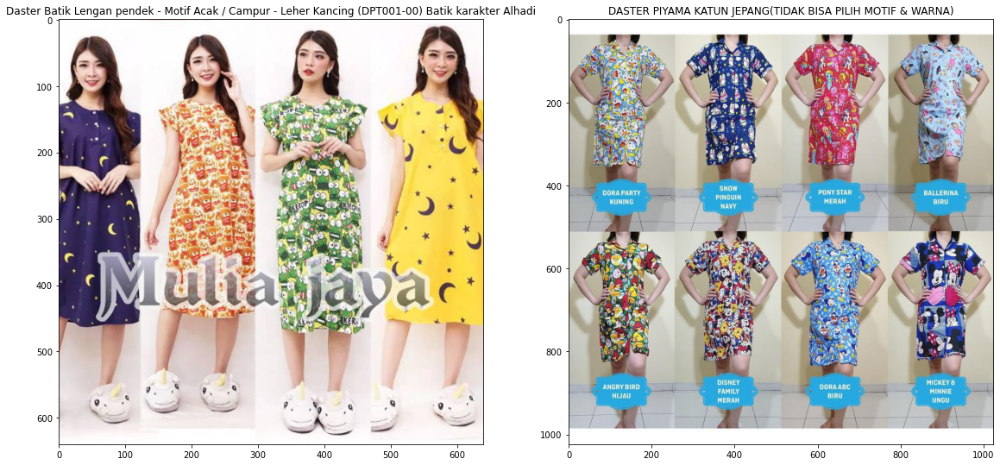

In [73]:
# Show matching images and titles of 'train_2406599165'
show_images_combined(train, 'train_2406599165', matches=True)

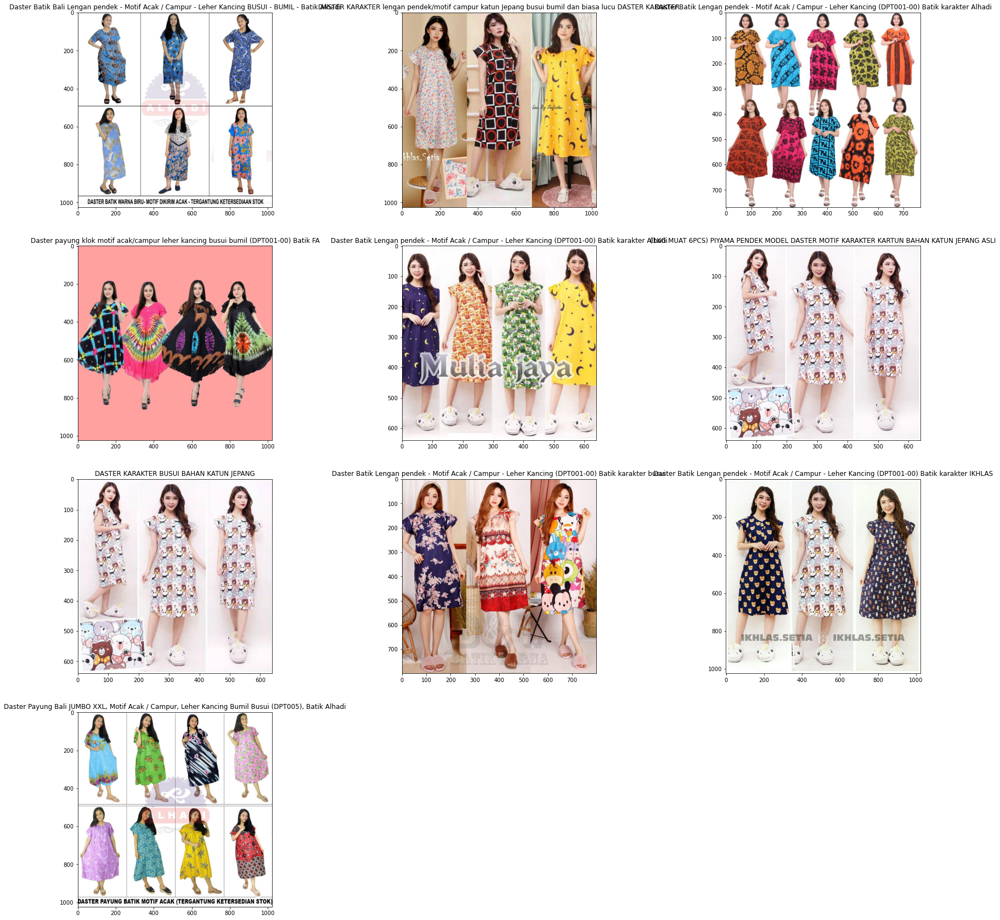

In [74]:
# Show predicted images and titles of 'train_2406599165' from model 0
show_images_combined(train, 'train_2406599165', model=0, matches=False)

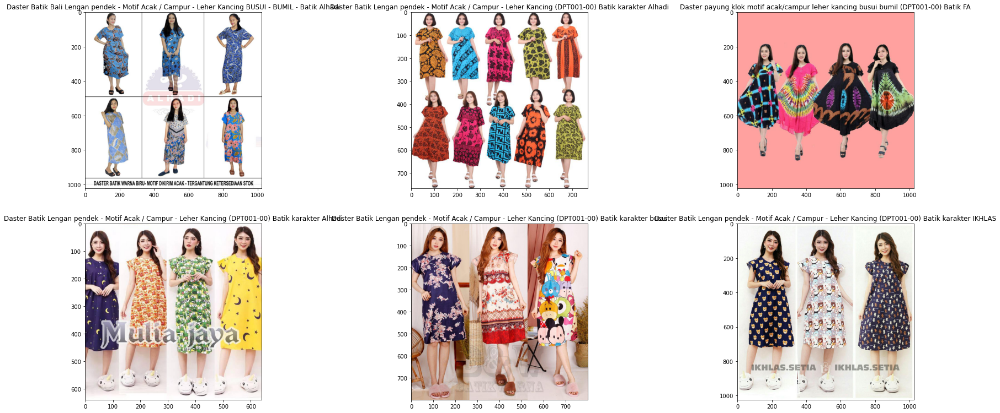

In [75]:
# Show predicted images and titles of 'train_2406599165' from model 1
show_images_combined(train, 'train_2406599165', model=1, matches=False)

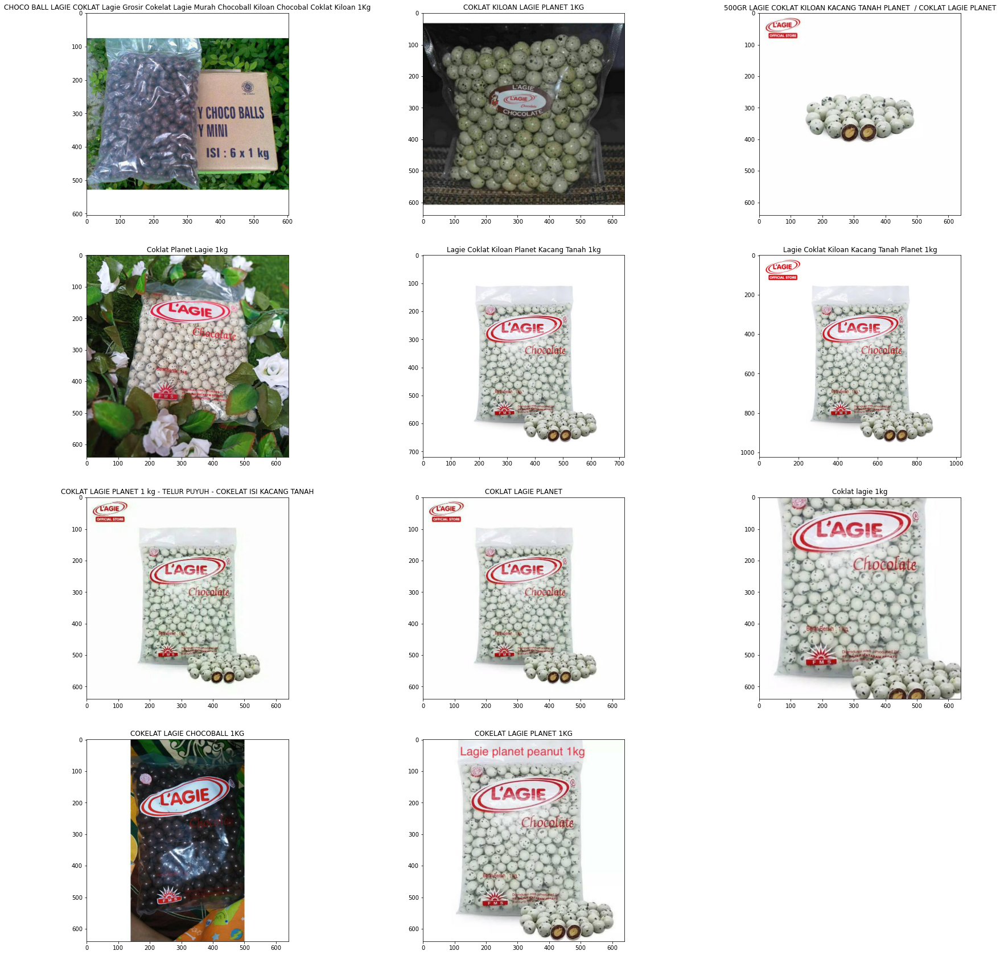

In [38]:
# Show matching images and titles of 'train_1396146683'
show_images_combined(train, 'train_1396146683', matches=True)

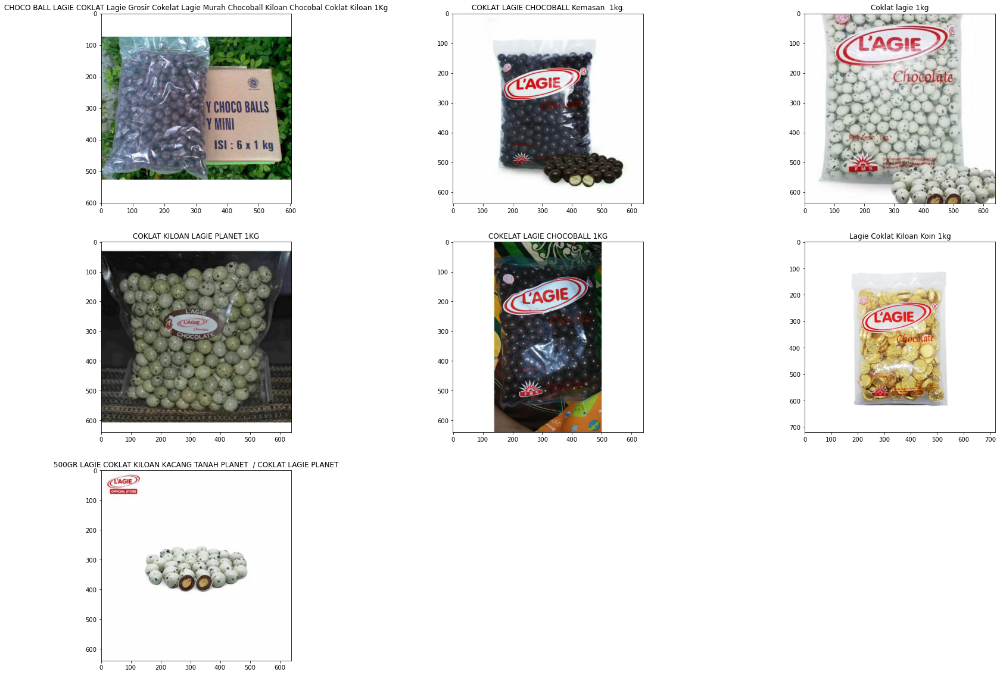

In [39]:
# Show predicted images and titles of 'train_1396146683' from model 0
show_images_combined(train, 'train_1396146683', model=0, matches=False)

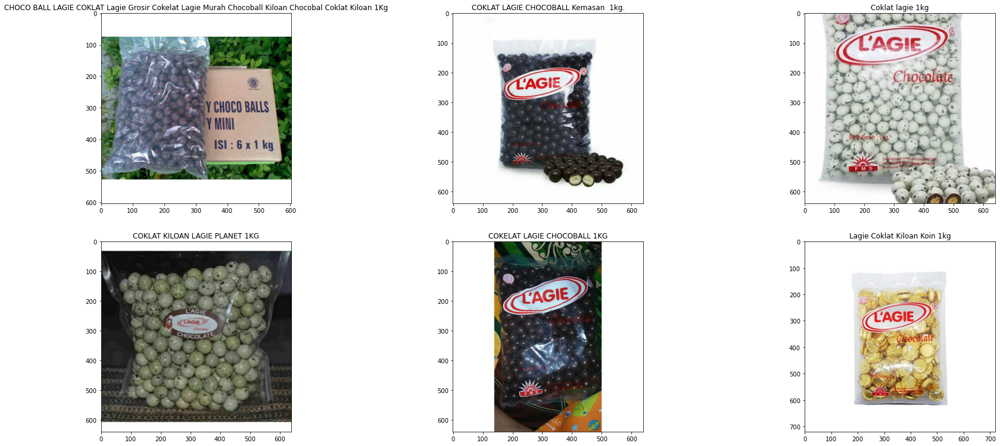

In [40]:
# Show predicted images and titles of 'train_1396146683' from model 1
show_images_combined(train, 'train_1396146683', model=1, matches=False)

#### Set Union Scores < Best Image Scores

There are some products where the set union scores are lower compared to the best image scores.

Examine these images / titles to see how we may retain the higher image scores.

In [43]:
# Locate predictions where set union is better than / equal to text but worse than image
train.loc[((train['combined_scores_0'] < train['best_image_scores_0']) & (train['combined_scores_0'] >= train['best_text_scores_0']) & \
           (train['combined_scores_1'] < train['best_image_scores_1']) & (train['combined_scores_1'] >= train['best_text_scores_1']))][view].head()

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1,match_image_distances,match_text_distances,pred_image_distances,pred_text_distances,pred_image_distances_avg,pred_text_distances_avg
8,train_86570404,"[LOGU] Tempelan kulkas magnet angka, tempelan ...","[train_86570404, train_2837452969, train_77364...",[train_86570404],"[train_115157077, train_2269068443, train_2837...",0.75,"[train_115157077, train_2269068443, train_2837...",0.75,"[0.0, 7.38, 7.38]","[0.0, 1.002, 1.314]","[0.0, 7.38, 7.38, 14.53, 18.76, 19.01, 19.26, ...","[0.0, 0.72, 0.781, 0.976, 1.0, 1.0, 1.0, 1.0, ...",20.23,1.132
16,train_3009013664,MARKS & SPENCER - Rose Hand & Body Lotion 250 ml,"[train_3009013664, train_3448377589]",[train_3009013664],"[train_1248209230, train_2047191940, train_236...",0.5,"[train_1248209230, train_236461645, train_3009...",0.571429,"[0.0, 10.53]","[0.0, 0.803]","[0.02, 10.53, 12.12, 12.16, 12.9, 13.26, 14.0,...","[0.0, 0.704, 0.704, 0.803, 0.842, 0.863, 0.969...",14.69,1.094
26,train_2905529497,Masker Medis 3ply Earloop (50pcs) - Masker 3pl...,"[train_2905529497, train_869563964]",[train_2905529497],"[train_109788017, train_1166693195, train_1782...",0.222222,"[train_2905529497, train_856120369]",0.5,"[0.0, 17.23]","[0.0, 0.924]","[0.01, 15.93, 16.03, 16.05, 16.16, 16.25, 16.3...","[0.0, 0.766, 0.781, 0.811, 0.854, 0.871, 0.898...",16.459999,1.002
30,train_1617041019,Molina Kaftan / YADITA SPARKLE KAFTAN / KEANU ...,"[train_1617041019, train_2772927896]",[train_1617041019],"[train_1210102540, train_1617041019, train_176...",0.5,"[train_1210102540, train_1617041019, train_176...",0.5,"[0.0, 13.88]","[0.0, 0.772]","[0.02, 11.9, 12.09, 12.2, 12.37, 12.44, 12.59,...","[0.0, 0.763, 0.772, 0.782, 0.892, 0.895, 0.947...",12.94,1.179
32,train_1461445798,Alat Facial Wajah 5 in 1 / Face Beauty Care Ma...,"[train_1461445798, train_1749322479]",[train_1461445798],"[train_1461445798, train_1749322479, train_318...",0.8,"[train_1461445798, train_1749322479, train_318...",0.8,"[0.0, 1.86]","[0.0, 0.956]","[0.0, 1.86, 16.88, 16.88, 16.89, 16.91, 16.99,...","[0.0, 0.512, 0.956, 0.958, 1.0, 1.0, 1.0, 1.0,...",16.940001,1.137


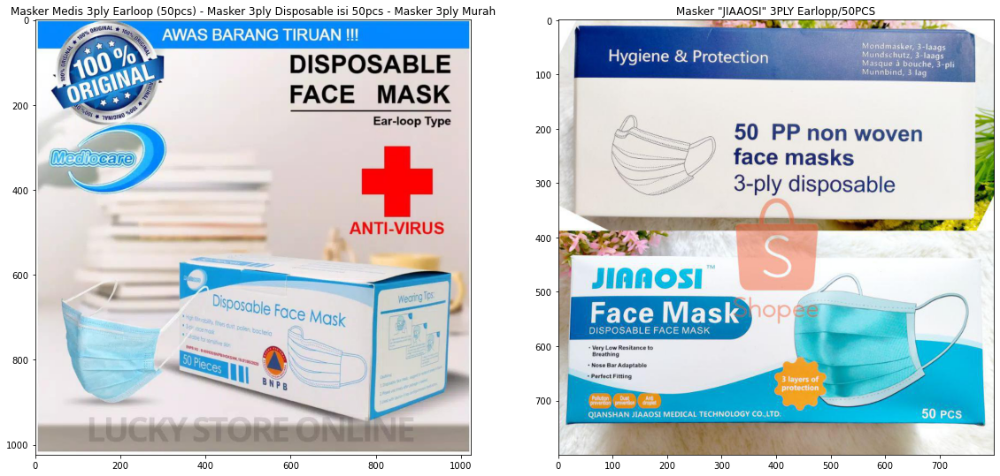

In [44]:
# Show matching images and titles of 'train_2905529497'
show_images_combined(train, 'train_2905529497', matches=True)

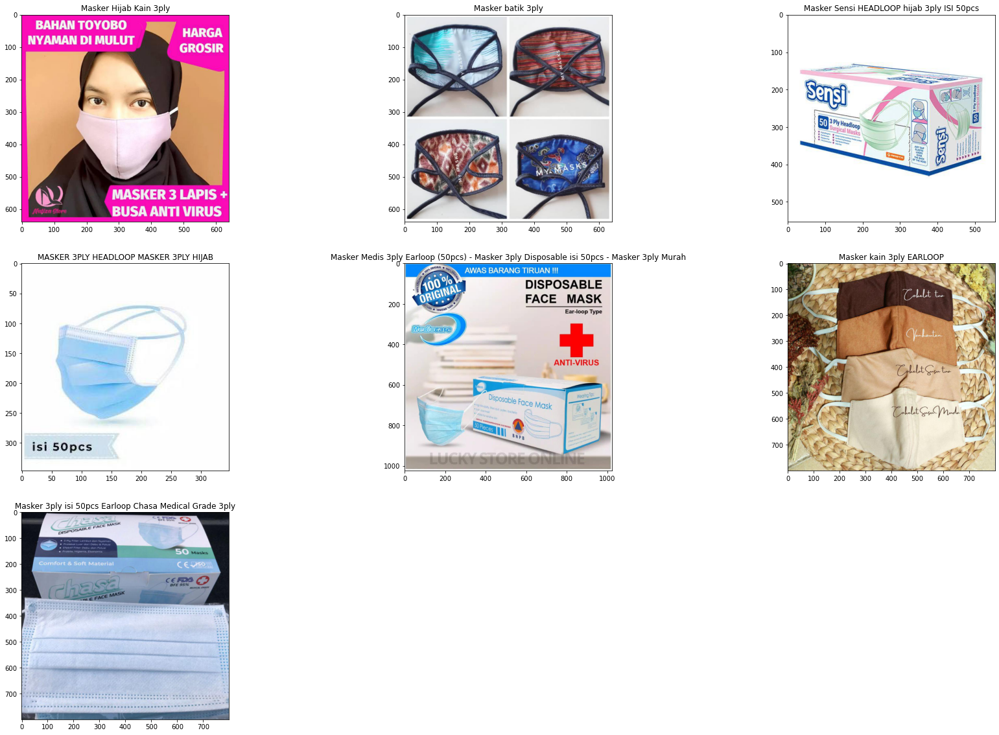

In [45]:
# Show predicted images and titles of 'train_2905529497' from model 0
show_images_combined(train, 'train_2905529497', model=0, matches=False)

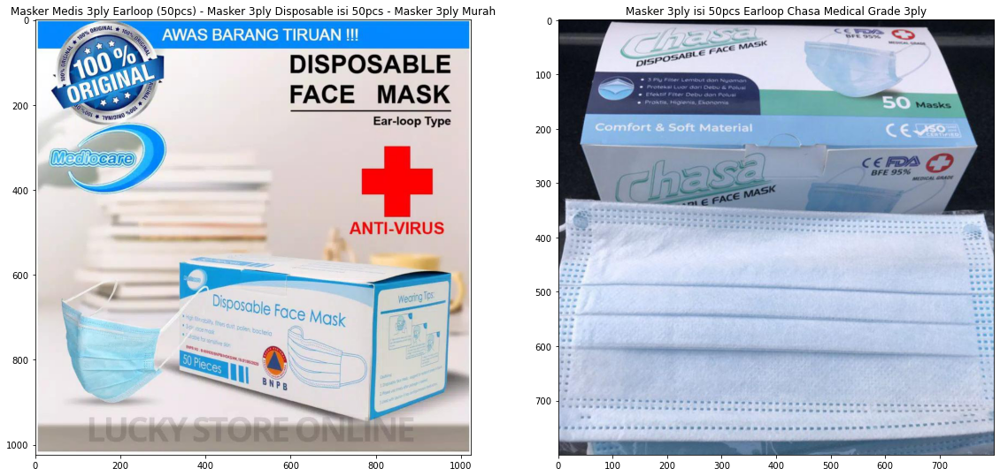

In [46]:
# Show predicted images and titles of 'train_2905529497' from model 1
show_images_combined(train, 'train_2905529497', model=1, matches=False)

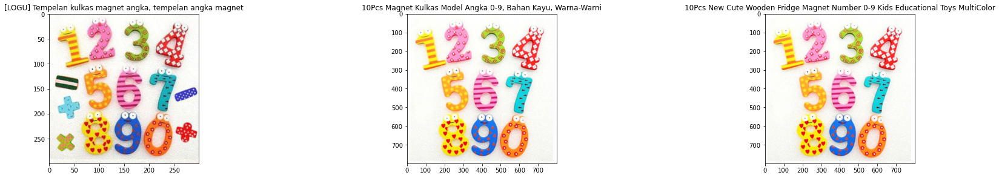

In [47]:
# Show matching images and titles of 'train_86570404'
show_images_combined(train, 'train_86570404', matches=True)

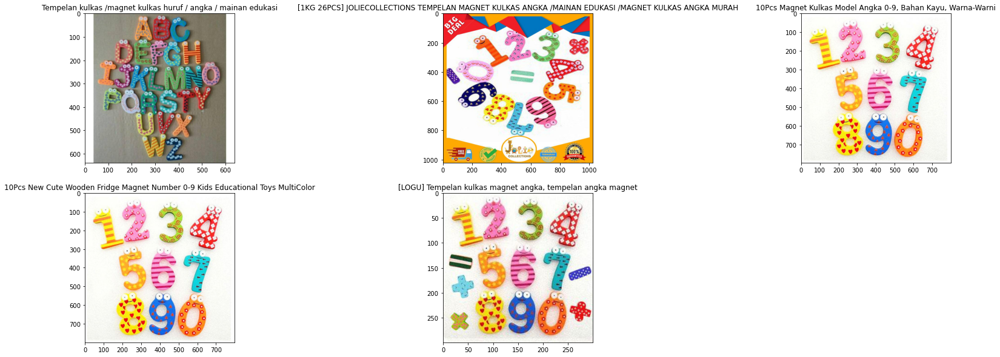

In [48]:
# Show predicted images and titles of 'train_86570404' from model 0
show_images_combined(train, 'train_86570404', model=0, matches=False)

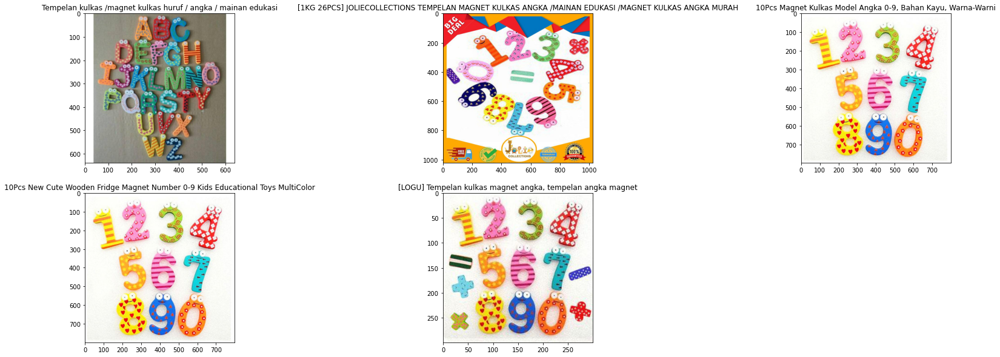

In [49]:
# Show predicted images and titles of 'train_86570404' from model 1
show_images_combined(train, 'train_86570404', model=1, matches=False)

#### Set Union Scores < Best Text Scores

There are some products where the set union scores are lower compared to the best text scores.

Examine these images / titles to see how we may retain the higher text scores.

In [50]:
# Locate predictions where set union is better than / equal to image but worse than text
train.loc[((train['combined_scores_0'] < train['best_text_scores_0']) & (train['combined_scores_0'] >= train['best_image_scores_0']) & \
           (train['combined_scores_1'] < train['best_text_scores_1']) & (train['combined_scores_1'] >= train['best_image_scores_1']))][view].head()

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1,match_image_distances,match_text_distances,pred_image_distances,pred_text_distances,pred_image_distances_avg,pred_text_distances_avg
31,train_2410183091,B33F My Food Shop Shopping Trolley - ST. 003 t...,"[train_2410183091, train_2529718493, train_304...",[train_2410183091],"[train_143394667, train_1504499709, train_2410...",0.571429,"[train_143394667, train_1504499709, train_2410...",0.571429,"[0.0, 14.74, 9.12]","[0.0, 1.251, 0.793]","[0.0, 7.31, 8.33, 9.12, 14.74, 16.07, 16.19, 1...","[0.0, 0.793, 1.0, 1.0, 1.0, 1.0, 1.018, 1.148,...",16.309999,1.181
38,train_4146813717,Soti Antiseptic Spray 100ml,"[train_4146813717, train_2095066661, train_257...",[train_4146813717],"[train_1829436365, train_1880996073, train_209...",0.545455,"[train_1880996073, train_2095066661, train_257...",0.666667,"[0.0, 18.51, 18.85]","[0.0, 0.829, 0.482]","[0.01, 9.67, 9.67, 9.7, 10.09, 10.1, 12.46, 12...","[0.0, 0.482, 0.829, 1.0, 1.0, 1.0, 1.0, 1.033,...",13.24,1.16
46,train_2679824623,Marcks Teens Compact Powder,"[train_2679824623, train_3116514616, train_108...",[train_2679824623],"[train_1081627741, train_1481142988, train_152...",0.857143,"[train_1081627741, train_1481142988, train_152...",0.75,"[0.0, 15.35, 8.73, 15.25, 14.1, 14.23, 14.72, ...","[0.0, 0.944, 0.0, 0.523, 0.628, 0.842, 0.628, ...","[0.02, 8.73, 9.8, 10.23, 10.89, 12.41, 12.45, ...","[0.0, 0.0, 0.523, 0.523, 0.523, 0.523, 0.523, ...",13.71,0.94
64,train_3286978516,MIAO ANTICRACK / ANTI CRACK CASE FOR ALL TYPE ...,"[train_3286978516, train_782197349, train_1952...",[train_3286978516],"[train_285976786, train_3156194756, train_3286...",0.222222,"[train_285976786, train_3156194756, train_3286...",0.222222,"[0.0, 15.91, 15.24]","[0.0, 1.222, 1.069]","[0.0, 5.44, 7.43, 7.61, 7.72, 7.97, 13.74, 14....","[0.0, 0.511, 1.0, 1.0, 1.0, 1.0, 1.034, 1.069,...",14.3,1.113
94,train_1889514443,Pasta Gigi Ciptadent Maxy 12 Plus Fresh Mint 190g,"[train_1889514443, train_2895116276, train_220...",[train_1889514443],"[train_1062277934, train_143666014, train_1889...",0.75,"[train_1062277934, train_143666014, train_1889...",0.75,"[0.0, 6.91, 12.6, 6.96]","[0.0, 0.459, 0.998, 0.735]","[0.02, 6.91, 6.96, 10.02, 11.07, 12.32, 12.38,...","[0.0, 0.459, 0.735, 0.998, 1.0, 1.0, 1.0, 1.0,...",14.52,1.146


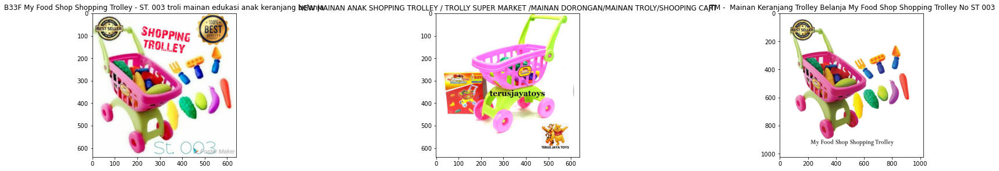

In [51]:
# Show matching images and titles of 'train_2410183091'
show_images_combined(train, 'train_2410183091', matches=True)

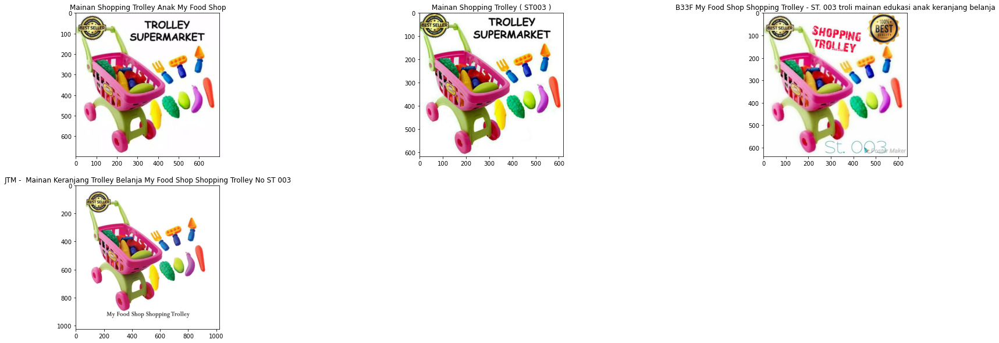

In [52]:
# Show predicted images and titles of 'train_2410183091' from model 0
show_images_combined(train, 'train_2410183091', model=0, matches=False)

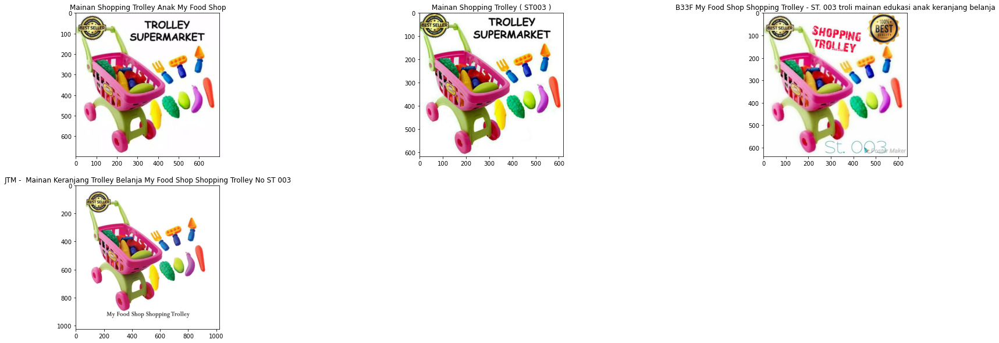

In [53]:
# Show predicted images and titles of 'train_2410183091' from model 1
show_images_combined(train, 'train_2410183091', model=1, matches=False)

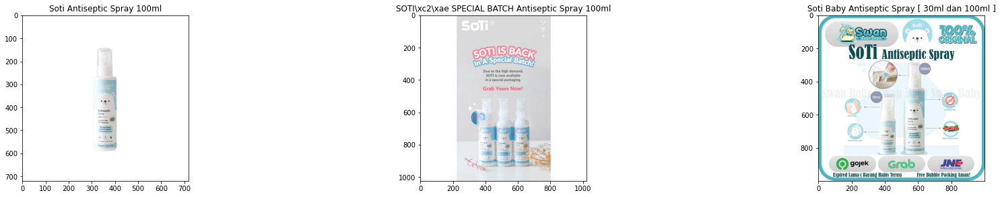

In [54]:
# Show matching images and titles of 'train_4146813717'
show_images_combined(train, 'train_4146813717', matches=True)

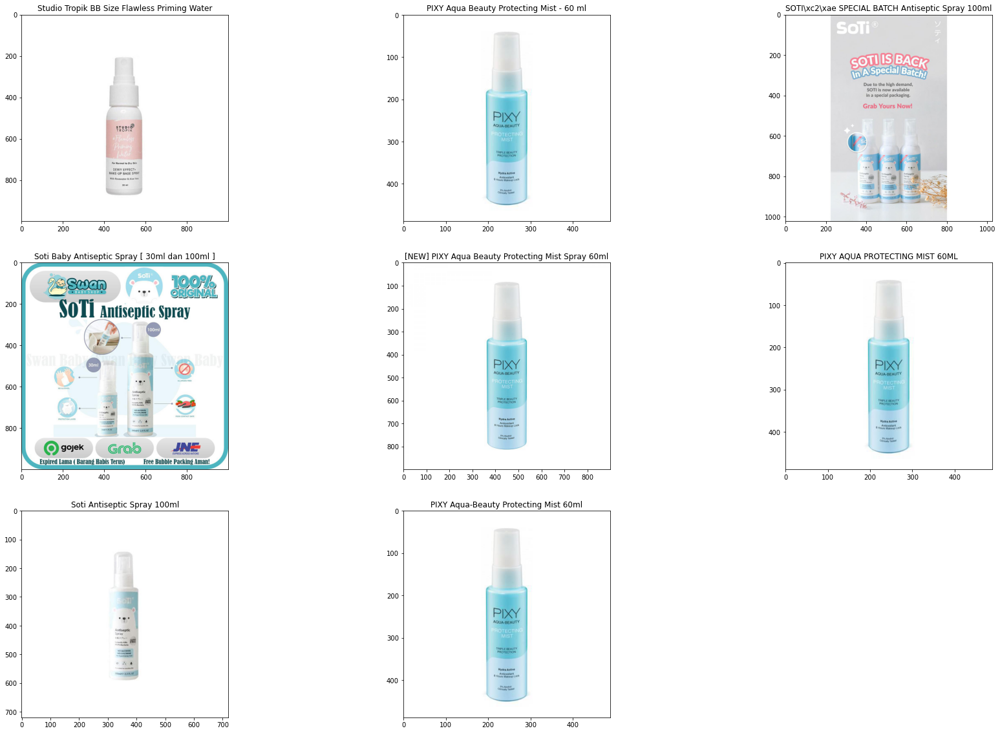

In [55]:
# Show predicted images and titles of 'train_4146813717' from model 0
show_images_combined(train, 'train_4146813717', model=0, matches=False)

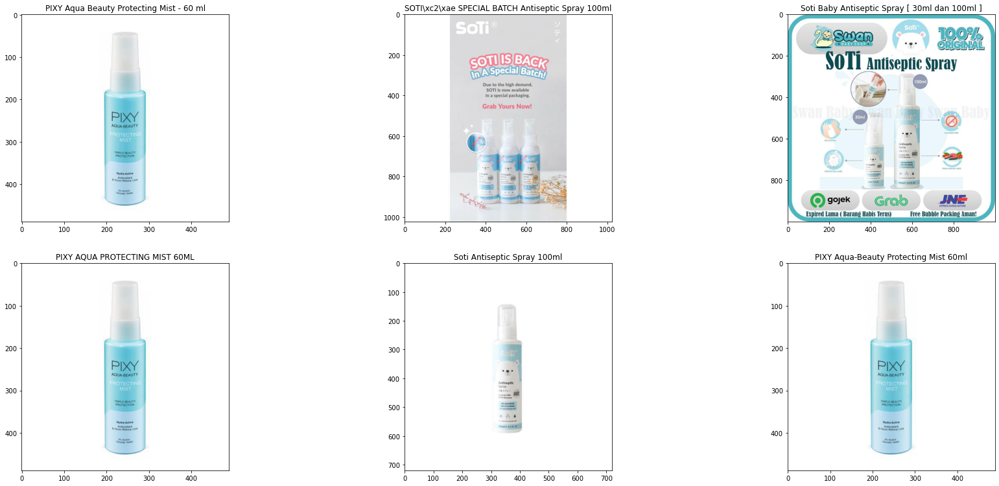

In [56]:
# Show predicted images and titles of 'train_4146813717' from model 1
show_images_combined(train, 'train_4146813717', model=1, matches=False)

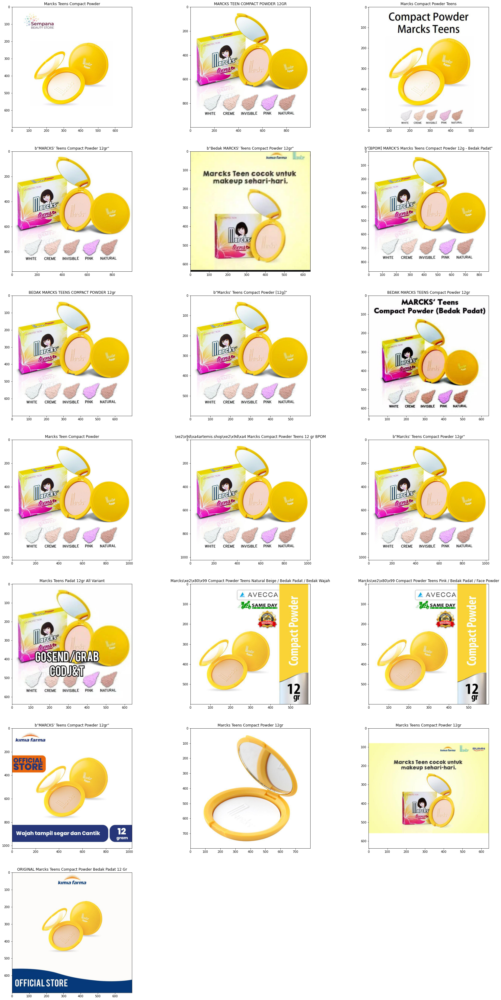

In [57]:
# Show matching images and titles of 'train_2679824623'
show_images_combined(train, 'train_2679824623', matches=True)

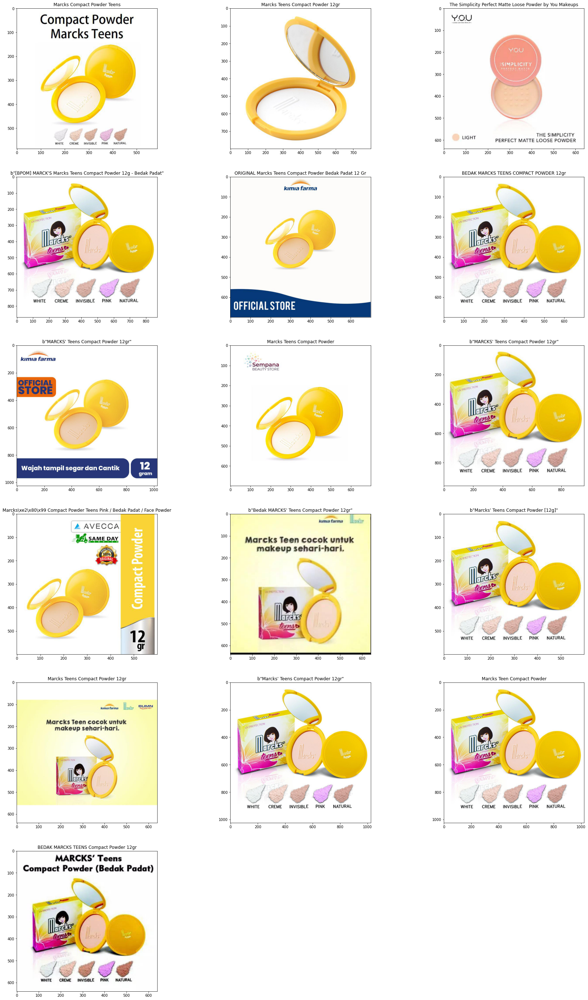

In [58]:
# Show predicted images and titles of 'train_2679824623' from model 0
show_images_combined(train, 'train_2679824623', model=0, matches=False)

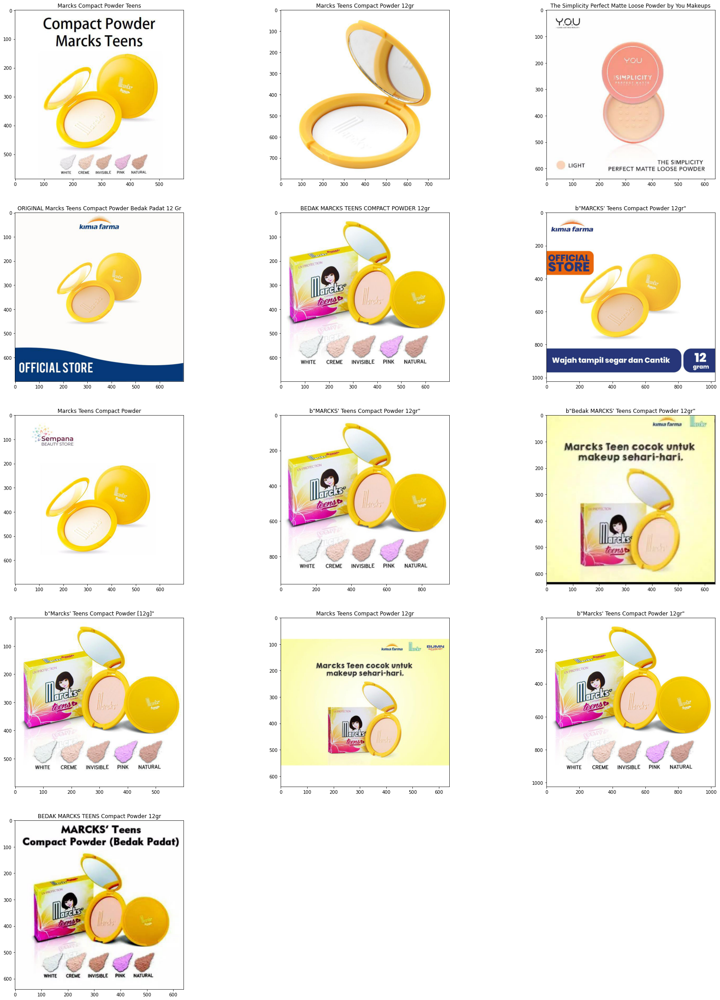

In [59]:
# Show predicted images and titles of 'train_2679824623' from model 1
show_images_combined(train, 'train_2679824623', model=1, matches=False)

#### F1 Scores = 0.5 or 0.4

After 1.0, 0.667, and 0.8, the next most frequent scores are 0.5 and 0.4.

Examine these images / titles to see how their scores may be improved.

In [65]:
# Locate predictions where combined score is 0.5
train.loc[((train['combined_scores_0'] == 0.5) & (train['combined_scores_1'] == 0.5))][view].head()

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1,match_image_distances,match_text_distances,pred_image_distances,pred_text_distances,pred_image_distances_avg,pred_text_distances_avg
30,train_1617041019,Molina Kaftan / YADITA SPARKLE KAFTAN / KEANU ...,"[train_1617041019, train_2772927896]",[train_1617041019],"[train_1210102540, train_1617041019, train_176...",0.5,"[train_1210102540, train_1617041019, train_176...",0.5,"[0.0, 13.88]","[0.0, 0.772]","[0.02, 11.9, 12.09, 12.2, 12.37, 12.44, 12.59,...","[0.0, 0.763, 0.772, 0.782, 0.892, 0.895, 0.947...",12.94,1.179
49,train_3743764071,Aloevera kiloan gel aloe vera curah lidah buay...,"[train_3743764071, train_3172872581, train_238...",[train_3743764071],[train_3743764071],0.5,[train_3743764071],0.5,"[0.0, 26.04, 30.32]","[0.0, 1.052, 1.052]","[0.02, 17.44, 18.34, 19.03, 19.13, 19.2, 19.31...","[0.0, 1.0, 1.0, 1.0, 1.0, 1.052, 1.052, 1.087,...",19.6,1.156
188,train_1360448474,SAMYUWAN PENGGEMUK BADAN,"[train_1360448474, train_144719847, train_3022...","[train_1360448474, train_144719847]","[train_1344984885, train_1360448474, train_144...",0.5,"[train_1344984885, train_1360448474, train_144...",0.5,"[0.0, 0.89, 14.24, 16.35]","[0.0, 1.414, 1.414, 1.058]","[0.0, 0.89, 14.24, 14.61, 14.61, 16.35, 16.58,...","[0.0, 0.615, 0.888, 0.932, 1.0, 1.0, 1.0, 1.0,...",18.059999,1.16
197,train_3668574065,MamyPoko Perekat Royal Soft - L 62 - Popok Tape,"[train_3668574065, train_4169864668]",[train_3668574065],"[train_2530102819, train_3446928223, train_366...",0.5,"[train_2530102819, train_3446928223, train_366...",0.5,"[0.0, 6.89]","[0.0, 1.157]","[0.0, 4.2, 6.89, 7.84, 8.76, 9.35, 11.72, 12.3...","[0.0, 0.679, 0.939, 0.939, 1.0, 1.0, 1.0, 1.0,...",13.05,1.118
227,train_1680128704,PLAZA KOREA - KIMCHI SAWI FRESH 500GR - MAKANA...,"[train_1680128704, train_2826678027]",[train_1680128704],"[train_1680128704, train_2811705706]",0.5,"[train_1680128704, train_2811705706]",0.5,"[0.0, 21.06]","[0.0, 0.969]","[0.0, 16.07, 16.17, 16.17, 16.17, 16.77, 16.81...","[0.0, 0.774, 0.907, 0.969, 1.0, 1.0, 1.0, 1.0,...",17.6,1.164


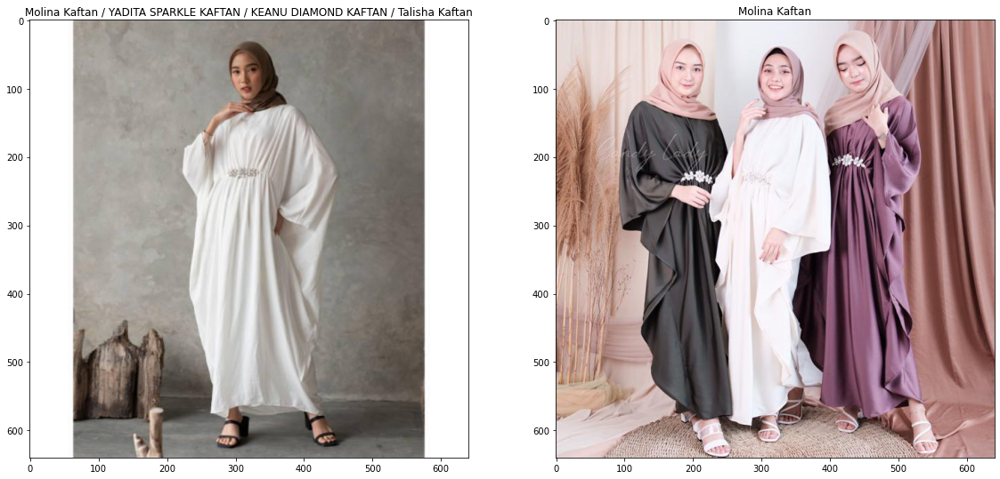

In [62]:
# Show matching images and titles of 'train_1617041019'
show_images_combined(train, 'train_1617041019', matches=True)

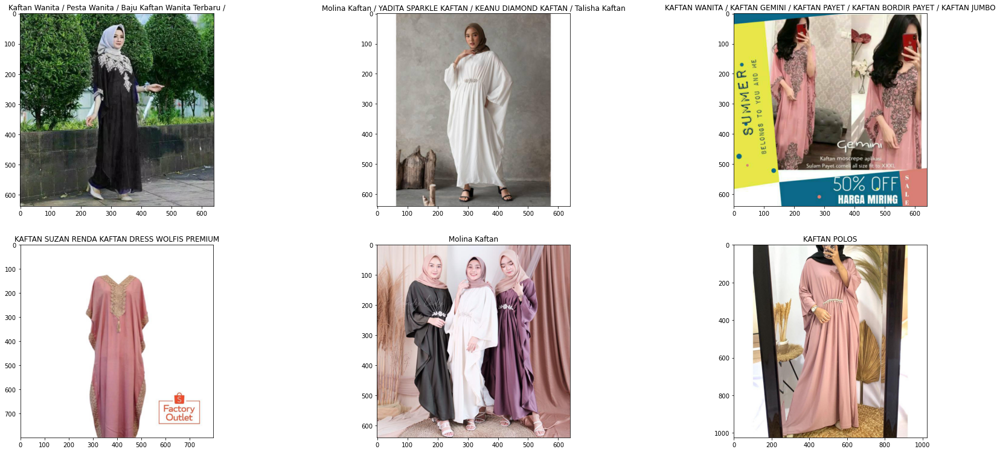

In [63]:
# Show predicted images and titles of 'train_1617041019' from model 0
show_images_combined(train, 'train_1617041019', model=0, matches=False)

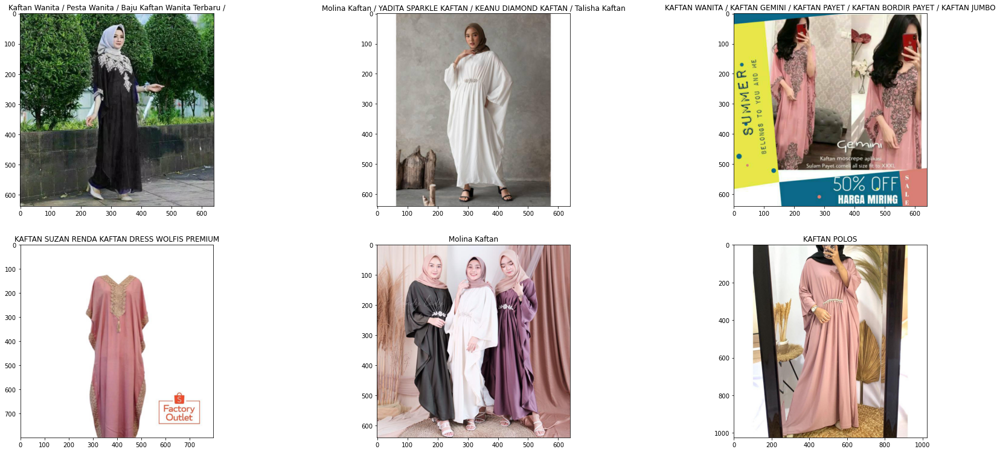

In [64]:
# Show predicted images and titles of 'train_1617041019' from model 1
show_images_combined(train, 'train_1617041019', model=1, matches=False)

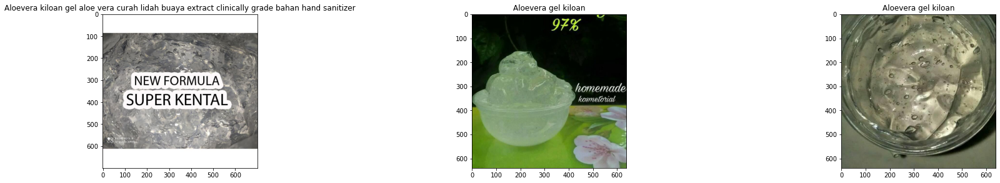

In [66]:
# Show matching images and titles of 'train_3743764071'
show_images_combined(train, 'train_3743764071', matches=True)

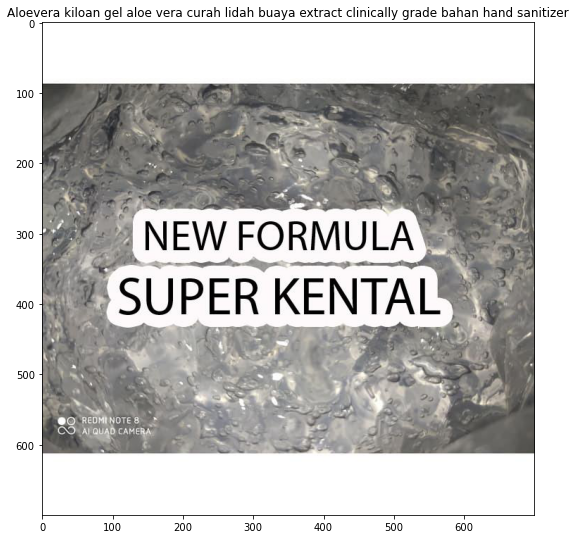

In [67]:
# Show predicted images and titles of 'train_3743764071' from model 0
show_images_combined(train, 'train_3743764071', model=0, matches=False)

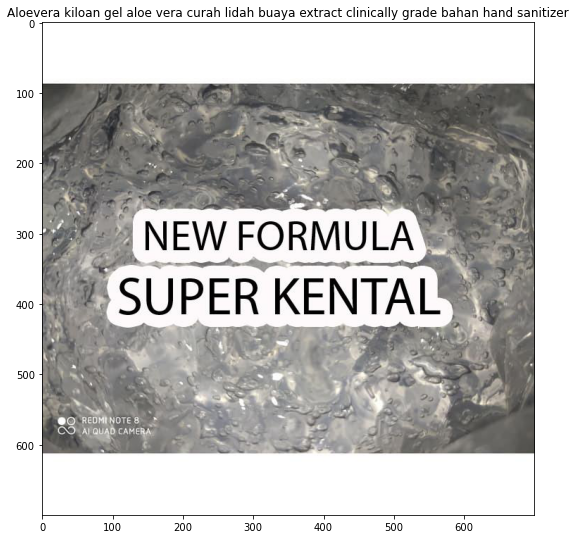

In [68]:
# Show predicted images and titles of 'train_3743764071' from model 1
show_images_combined(train, 'train_3743764071', model=1, matches=False)

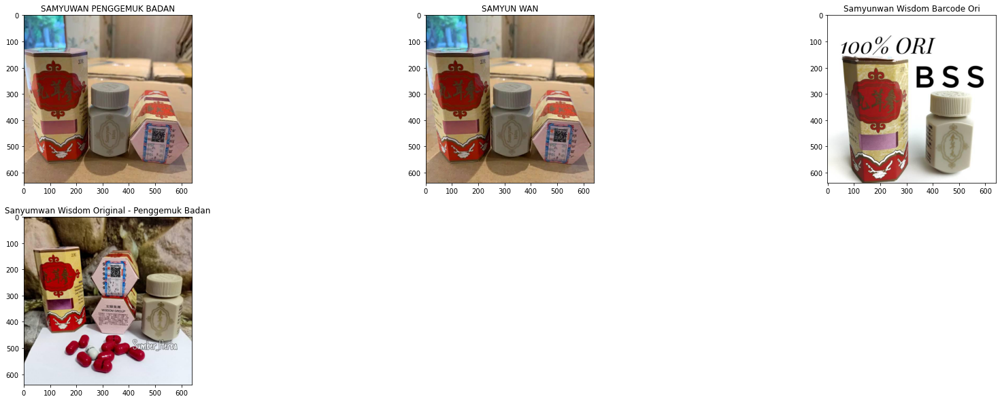

In [71]:
# Show matching images and titles of 'train_1360448474'
show_images_combined(train, 'train_1360448474', matches=True)

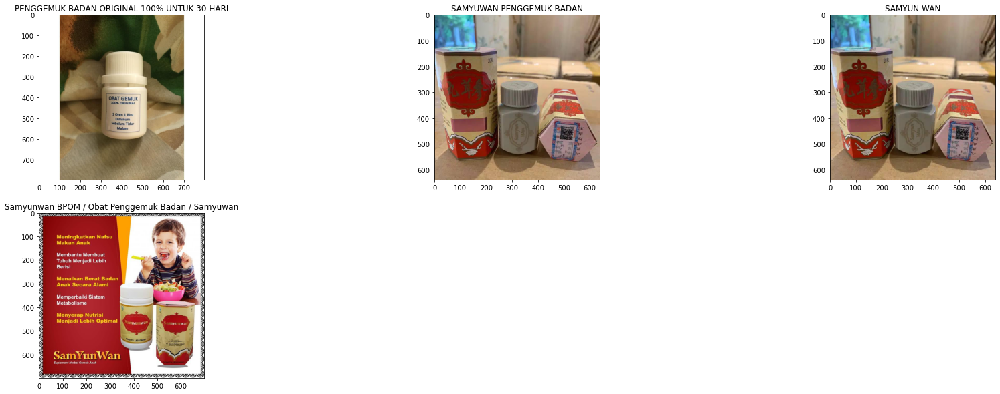

In [72]:
# Show predicted images and titles of 'train_1360448474' from model 0
show_images_combined(train, 'train_1360448474', model=0, matches=False)

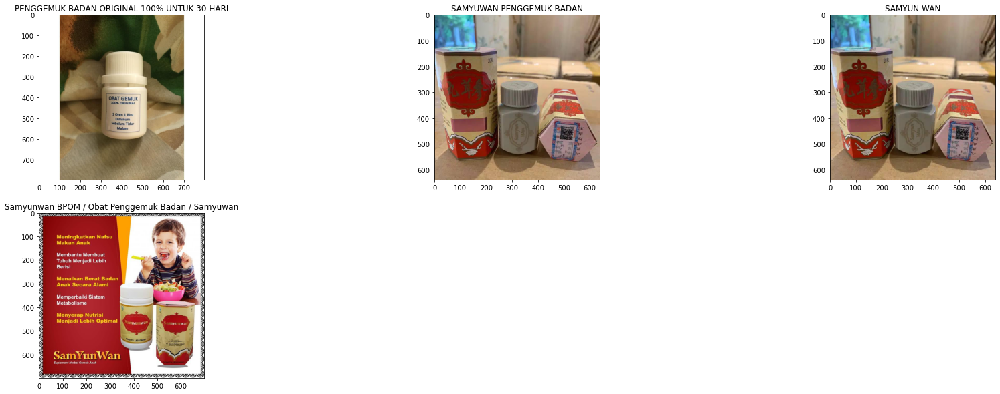

In [73]:
# Show predicted images and titles of 'train_1360448474' from model 1
show_images_combined(train, 'train_1360448474', model=1, matches=False)

In [74]:
# Locate predictions where combined score is 0.4
train.loc[((train['combined_scores_0'] == 0.4) & (train['combined_scores_1'] == 0.4))][view].head()

,posting_id,title,matches,image_duplicates,combined_preds_0,combined_scores_0,combined_preds_1,combined_scores_1,match_image_distances,match_text_distances,pred_image_distances,pred_text_distances,pred_image_distances_avg,pred_text_distances_avg
51,train_363659042,Lemari Pakaian Plastik Olymplast Odc 04 Susun ...,"[train_363659042, train_4224125539, train_9427...",[train_363659042],[train_363659042],0.4,[train_363659042],0.4,"[0.0, 13.41, 17.68, 13.84]","[0.0, 1.414, 1.414, 1.414]","[0.01, 13.41, 13.61, 13.84, 13.88, 16.21, 16.6...","[0.0, 1.0, 1.0, 1.0, 1.0, 1.047, 1.109, 1.124,...",17.82,1.192
163,train_438033632,khusus live total 2 kg,"[train_438033632, train_4090578972, train_2029...",[train_438033632],[train_438033632],0.4,[train_438033632],0.4,"[0.0, 24.81, 26.84, 24.06]","[0.0, 1.16, 1.195, 1.192]","[0.0, 19.81, 19.92, 20.12, 20.17, 20.21, 20.23...","[0.0, 0.954, 1.0, 1.0, 1.0, 1.0, 1.007, 1.079,...",20.379999,1.15
263,train_239626874,Habbat Nigellive Habbasyi plus Zaitun isi 100 ...,"[train_239626874, train_1853142092, train_3285...",[train_239626874],[train_239626874],0.4,[train_239626874],0.4,"[0.0, 16.12, 14.37, 14.37]","[0.0, 1.134, 0.909, 1.114]","[0.02, 14.37, 14.37, 14.88, 14.99, 15.03, 15.2...","[0.0, 0.909, 1.0, 1.0, 1.0, 1.0, 1.098, 1.112,...",15.69,1.166
327,train_461752132,PP Lite Kertas Fotocopy A4 75gr - 1 Ream (500 ...,"[train_461752132, train_1908288077]",[train_461752132],"[train_1507351506, train_4022562985, train_461...",0.4,"[train_1507351506, train_4022562985, train_461...",0.4,"[0.0, 16.43]","[0.0, 1.177]","[0.02, 14.41, 14.58, 14.63, 14.77, 14.82, 14.8...","[0.0, 0.791, 0.803, 1.0, 1.0, 1.0, 1.0, 1.096,...",15.28,1.18
359,train_2343196131,Vitamin B1 liqunox 100 ML,"[train_2343196131, train_3504936430, train_470...",[train_2343196131],[train_2343196131],0.4,[train_2343196131],0.4,"[0.0, 12.69, 16.41, 16.75]","[0.0, 0.967, 1.098, 1.01]","[0.0, 12.69, 14.27, 14.51, 14.52, 14.68, 14.7,...","[0.0, 0.967, 0.993, 1.0, 1.0, 1.0, 1.0, 1.01, ...",15.37,1.197


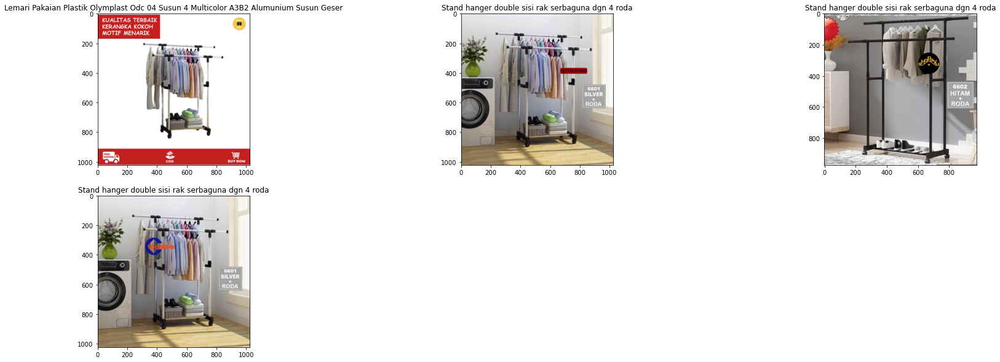

In [75]:
# Show matching images and titles of 'train_363659042'
show_images_combined(train, 'train_363659042', matches=True)

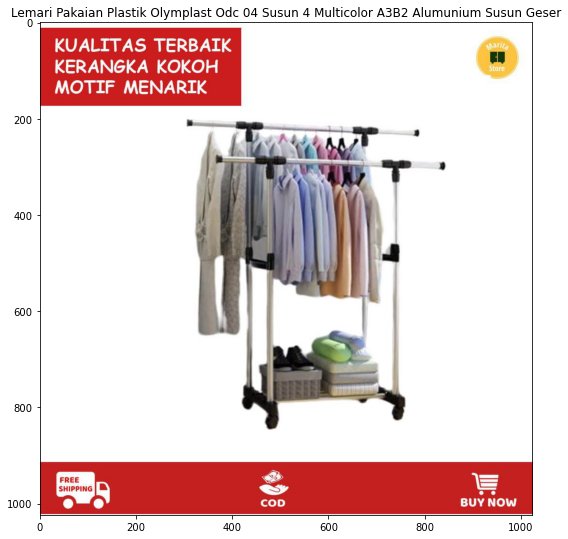

In [76]:
# Show predicted images and titles of 'train_363659042' from model 0
show_images_combined(train, 'train_363659042', model=0, matches=False)

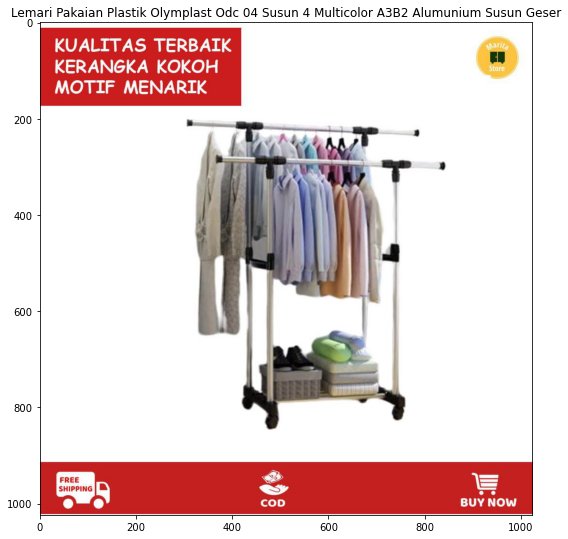

In [77]:
# Show predicted images and titles of 'train_363659042' from model 1
show_images_combined(train, 'train_363659042', model=1, matches=False)

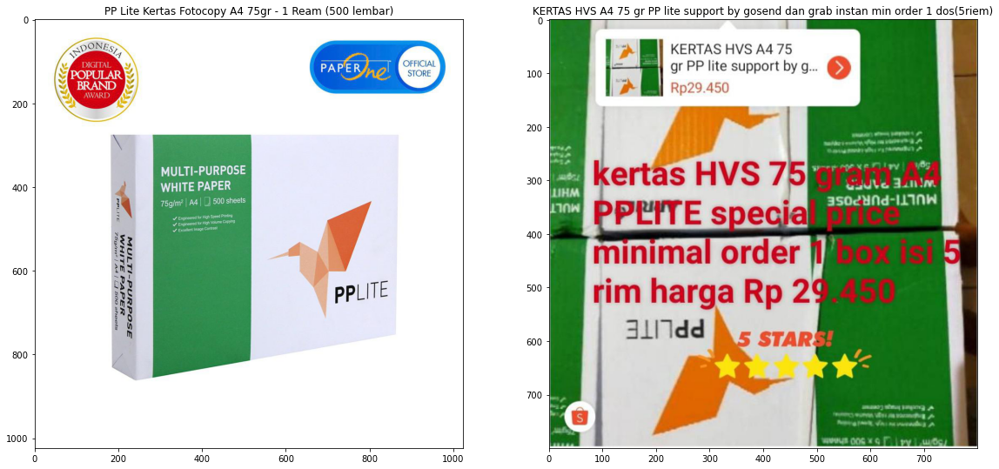

In [78]:
# Show matching images and titles of 'train_461752132'
show_images_combined(train, 'train_461752132', matches=True)

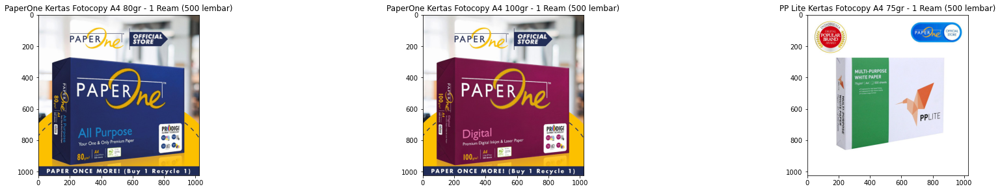

In [79]:
# Show predicted images and titles of 'train_461752132' from model 0
show_images_combined(train, 'train_461752132', model=0, matches=False)

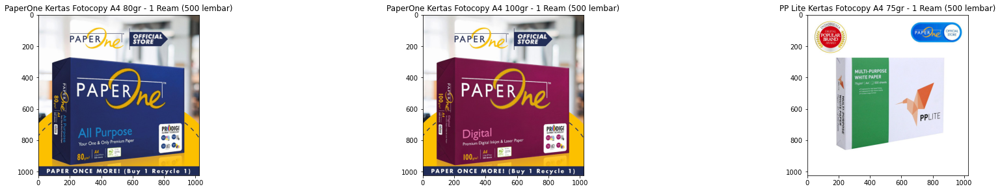

In [80]:
# Show predicted images and titles of 'train_461752132' from model 1
show_images_combined(train, 'train_461752132', model=1, matches=False)